In [1]:
%matplotlib inline

import seaborn as sns
import pandas as pd

import matplotlib
import numpy as np
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings('ignore')

import glob

In [2]:
def int_to_strtime(d):
    """convert int hhmm to str HH:MM """
    (h, s) = (d[:2], d[2:])
    timestr = h + ':' + s
    return timestr

In [3]:
path = r'C:\Users\groov\PythonCode\data\PortlandCrime'
filenames = glob.glob(path + "/*")
dfs = []

for filename in filenames:
    dfs.append(pd.read_csv(filename))
    
crimes = pd.concat(dfs, ignore_index=True)

# fix the occur_time format, add other datetime features
crimes['Occur Time'] = crimes['Occur Time'].apply('{:0>4}'.format)
crimes['Occur_time'] = crimes['Occur Time'].apply(int_to_strtime)
crimes['Occur_timestamp'] = pd.to_datetime(crimes['Occur Date'] + ' ' + crimes['Occur_time'])

crimes['Hour'] = crimes['Occur_timestamp'].dt.hour
crimes['Date'] = crimes['Occur_timestamp'].dt.date
crimes['Day_of_Week'] = crimes['Occur_timestamp'].dt.dayofweek
crimes['Year'] = crimes['Occur_timestamp'].dt.year

In [4]:
crimes.head(3)

,Address,Case Number,Crime Against,Neighborhood,Number of Records,Occur Date,Occur Month Year,Occur Time,Offense Category,Offense Count,...,Open Data X,Open Data Y,Report Date,Report Month Year,Occur_time,Occur_timestamp,Hour,Date,Day_of_Week,Year
0,NaN,15-X4397406,Person,NaN,1,1/1/06,1/1/06,1044,Sex Offenses,1,...,NaN,NaN,5/29/15,5/1/15,10:44,2006-01-01 10:44:00,10,2006-01-01,6,2006
1,NaN,15-X4299953,Person,NaN,1,1/15/07,1/1/07,1300,Sex Offenses,1,...,NaN,NaN,5/15/15,5/1/15,13:00,2007-01-15 13:00:00,13,2007-01-15,0,2007
2,6600 BLOCK OF SW PARKHILL DR,15-172868,Property,Hillsdale,1,3/21/08,3/1/08,0000,Fraud Offenses,1,...,7642860.0,667363.0,5/26/15,5/1/15,00:00,2008-03-21 00:00:00,0,2008-03-21,4,2008


In [5]:
cby = crimes[['Year', 'Neighborhood', 'Case Number']]
cby = cby[cby['Year'] > 2014]

agg = cby.groupby(by=['Year', 'Neighborhood']).agg('count')
agg.reset_index(inplace=True)
agg.columns = ['Year', 'Neighborhood', 'Count']
agg.set_index('Neighborhood', inplace=True)
agg.sort_values(by='Count', ascending=False, inplace=True)


pvt = pd.pivot_table(agg, values='Count', index='Neighborhood', columns='Year')
pvt['Total'] = pvt.sum(axis=1)
pvt.sort_values(by='Total', ascending=False, inplace=True)

pvt.head(3)

Year,2015,2016,2017,2018,Total
Neighborhood,,,,,
Downtown,10810.0,15734.0,14900.0,963.0,42407.0
Hazelwood,10738.0,15948.0,14103.0,1008.0,41797.0
Lents,5989.0,8714.0,8170.0,567.0,23440.0


In [6]:
# compare crime types by year
crime_types = crimes[['Year', 'Neighborhood', 'Offense Category', 'Offense Count']]
crime_types = crime_types[crime_types['Year'] > 2014]
crime_types_by_nbhd = crime_types.groupby(by=['Neighborhood', 'Offense Category', 'Year']).agg('count')
crime_types_by_nbhd.head(100)

Offense Count
Neighborhood Offense Category         Year               
Alameda      Assault Offenses         2015             20
                                      2016             16
                                      2017             37
                                      2018              3
             Burglary                 2015             48
                                      2016             84
                                      2017             72
             Counterfeiting/Forgery   2016              4
                                      2017              4
             Embezzlement             2015              4
             Fraud Offenses           2015             72
                                      2016             40
                                      2017             41
             Kidnapping/Abduction     2015              8
             Larceny Offenses         2015            172
                                      2016            280
                                      2017            212
                                      2018             12
             Motor Vehicle Theft      2015             44
                                      2016             88
                                      2017            114
                                      2018              3
             Sex Offenses             2017              7
             Vandalism                2015             48
                                      2016             40
                                      2017             45
             Weapon Law Violations    2016              4
                                      2018              3
Arbor Lodge  Arson                    2016              4
                                      2017             12
...                                                   ...
             Stolen Property Offenses 2016              4
             Vandalism                2015            108
                                      2016            160
                                      2017            173
                                      2018             15
             Weapon Law Violations    2015              4
                                      2016             16
                                      2017              4
Ardenwald    Assault Offenses         2015              4
                                      2016             12
                                      2017             14
                                      2018              3
             Burglary                 2015             24
                                      2016             20
                                      2017             16
             Counterfeiting/Forgery   2016              4
             Fraud Offenses           2015             16
                                      2016             12
                                      2017             19
             Larceny Offenses         2015             16
                                      2016             68
                                      2017             74
             Motor Vehicle Theft      2015             20
                                      2016             16
                                      2017             18
             Robbery                  2017              4
             Sex Offenses             2016              8
                                      2017              3
             Vandalism                2016             12
                                      2017             20

[100 rows x 1 columns]

In [7]:
def show_neighborhood_breakdown(neighborhood):
    results = crime_types_by_nbhd.unstack().loc[neighborhood]
    results['total'] = results.sum(axis=1)
    results.sort_values(by='total', ascending=False, inplace=True)
    results.drop(['total'], axis=1, inplace=True)
    results[0:10].plot.barh(figsize=(10, 8))
    plt.gca().invert_yaxis()

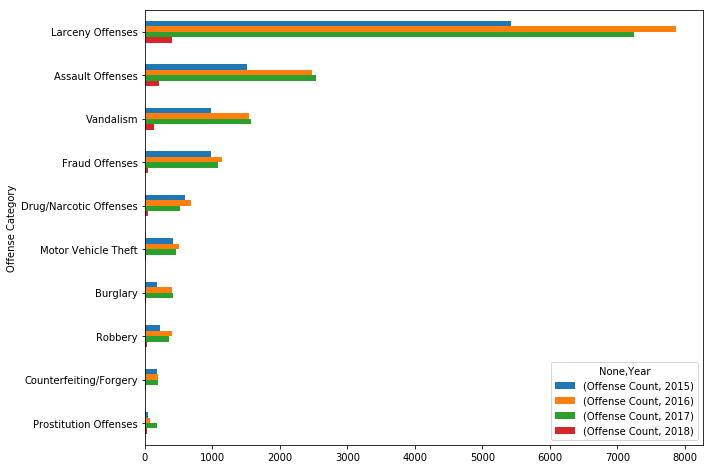

In [8]:
neighborhood = 'Downtown'
show_neighborhood_breakdown(neighborhood)

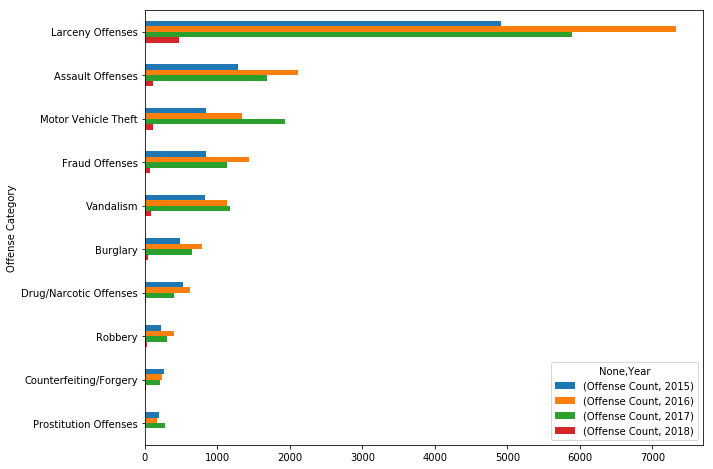

In [9]:
neighborhood = 'Hazelwood'
show_neighborhood_breakdown(neighborhood)

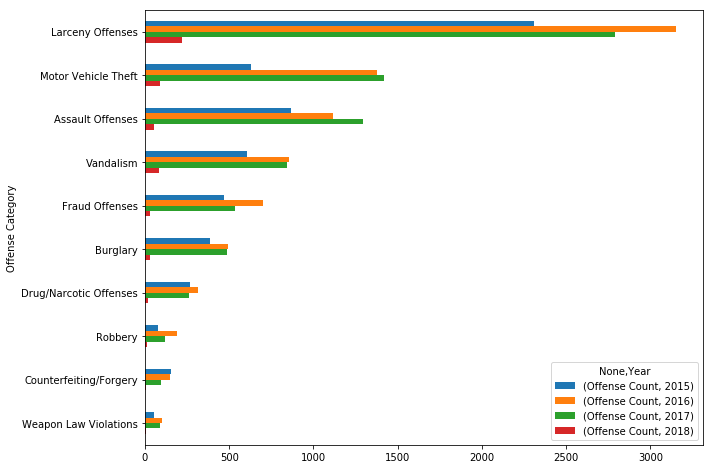

In [10]:
neighborhood = 'Lents'
show_neighborhood_breakdown(neighborhood)

In [11]:
crimes.head(3)

,Address,Case Number,Crime Against,Neighborhood,Number of Records,Occur Date,Occur Month Year,Occur Time,Offense Category,Offense Count,...,Open Data X,Open Data Y,Report Date,Report Month Year,Occur_time,Occur_timestamp,Hour,Date,Day_of_Week,Year
0,NaN,15-X4397406,Person,NaN,1,1/1/06,1/1/06,1044,Sex Offenses,1,...,NaN,NaN,5/29/15,5/1/15,10:44,2006-01-01 10:44:00,10,2006-01-01,6,2006
1,NaN,15-X4299953,Person,NaN,1,1/15/07,1/1/07,1300,Sex Offenses,1,...,NaN,NaN,5/15/15,5/1/15,13:00,2007-01-15 13:00:00,13,2007-01-15,0,2007
2,6600 BLOCK OF SW PARKHILL DR,15-172868,Property,Hillsdale,1,3/21/08,3/1/08,0000,Fraud Offenses,1,...,7642860.0,667363.0,5/26/15,5/1/15,00:00,2008-03-21 00:00:00,0,2008-03-21,4,2008


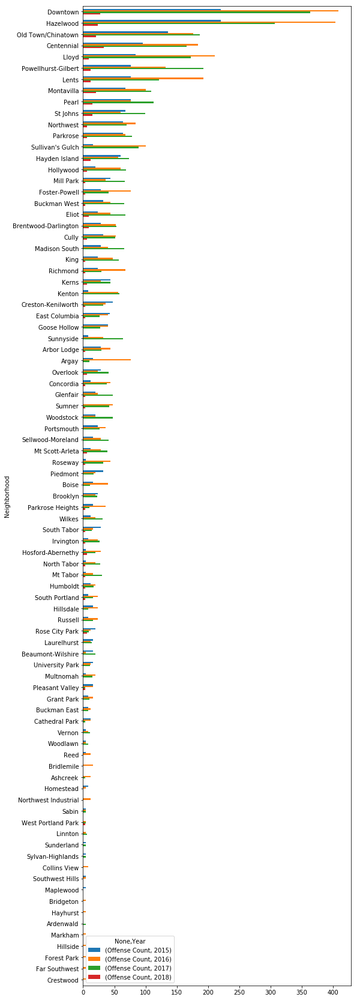

In [12]:
assaults = crimes[crimes['Offense Category']=='Robbery']
assaults = assaults[['Year', 'Neighborhood', 'Offense Count']]
assaults = assaults[assaults['Year'] > 2014]
assaults = assaults.groupby(by=['Neighborhood', 'Year']).agg('count')
assaults = assaults.unstack()
assaults['total'] = assaults.sum(axis=1)
assaults.sort_values(by='total', ascending=False, inplace=True)
assaults.drop(['total'], axis=1, inplace=True)
#assaults = assaults[0:20]
assaults.plot.barh(figsize=(8, 30))
plt.gca().invert_yaxis()

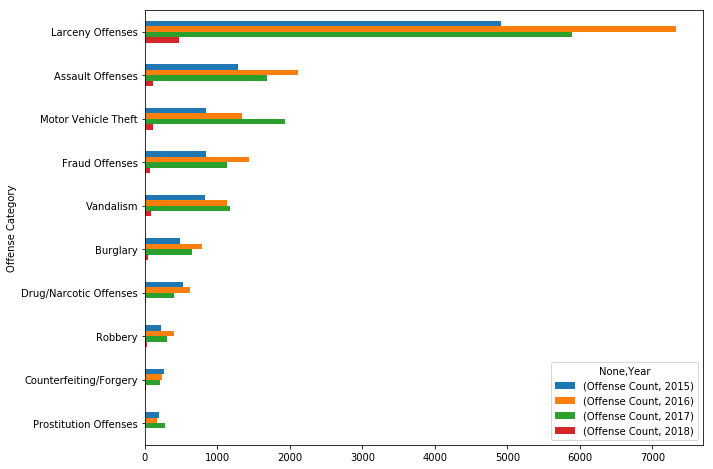

In [13]:
neighborhood = 'Hazelwood'
show_neighborhood_breakdown(neighborhood)

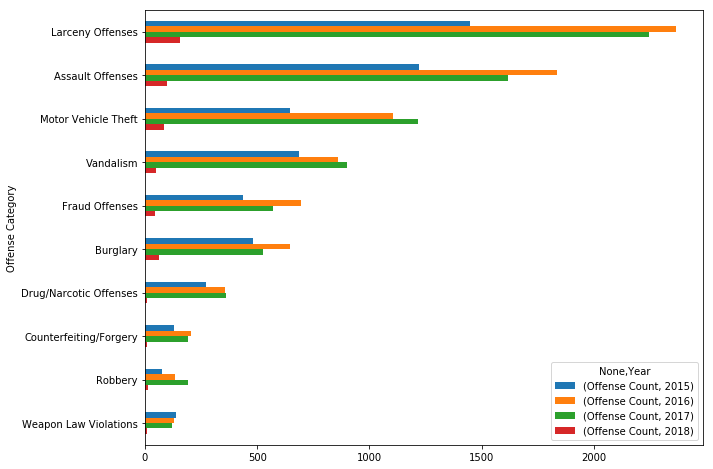

In [14]:
neighborhood = 'Powellhurst-Gilbert'
show_neighborhood_breakdown(neighborhood)

In [15]:
# fine a way to pull crime information by myself from various police departments

# gps to automatically detect current location
# lookup current neighborhood
# report top crime types
# show a map with pins for crimes

# build in social reporting

In [16]:
# data from: https://www.portlandoregon.gov/police/71978
# download with 'all fields' box checked or else it breaks
# updated the first business day after the 15th of every month

path = r'C:\Users\groov\PythonCode\data\PortlandCrime\PortlandCrimeData.csv'
df = pd.read_csv(path)

occur_dates = df['Occur Month Year'].str.split('/', expand=True)
occur_dates.columns = ['occur_month', 'occur_day', 'occur_year']
df = df.merge(occur_dates, left_index=True, right_index=True)


df['occur_month'] = df['occur_month'].astype('int')
df['occur_day'] = df['occur_day'].astype('int')
df['occur_year'] = df['occur_year'].astype('int')


df = df[df['occur_year'] > 2014]

columns = ['Crime Against', 'Neighborhood', 'Occur Time', 'Offense Category', 'Offense Type', 'Open Data Lat', 'Open Data Lon',
          'Open Data X', 'Open Data Y', 'occur_month', 'occur_day', 'occur_year']

df = df[columns]

df.columns = ['crime_against', 'neighborhood', 'occur_time', 'offense_category', 'offense_type', 'lat', 'lon', 'x', 'y',
             'occur_month', 'occur_day', 'occur_year']

columns = ['crime_against', 'neighborhood', 'offense_category', 'offense_type', 'lat', 'lon', 'x', 'y',
             'occur_month', 'occur_day', 'occur_year', 'occur_time']

df = df[columns]

In [17]:
df.head(3)

,crime_against,neighborhood,offense_category,offense_type,lat,lon,x,y,occur_month,occur_day,occur_year,occur_time
0,Person,Mill Park,Assault Offenses,Simple Assault,45.516734,-122.532365,7681208.0,681039.0,10,1,2016,829
1,Person,Buckman West,Assault Offenses,Simple Assault,45.514014,-122.658644,7648824.0,680887.0,10,1,2016,1113
2,Person,Brooklyn,Assault Offenses,Aggravated Assault,45.490331,-122.654233,7649724.0,672225.0,10,1,2016,20


In [18]:
cby = df[['occur_year', 'neighborhood', 'occur_day']]

agg = cby.groupby(by=['occur_year', 'neighborhood']).agg('count')
agg.reset_index(inplace=True)
agg.columns = ['occur_year', 'neighborhood', 'count']
agg.set_index('neighborhood', inplace=True)
agg.sort_values(by='count', ascending=False, inplace=True)


pvt = pd.pivot_table(agg, values='count', index='neighborhood', columns='occur_year')
pvt['total'] = pvt.sum(axis=1)
pvt.sort_values(by='total', ascending=False, inplace=True)

pvt.head(100)

occur_year,2015,2016,2017,2018,total
neighborhood,,,,,
Downtown,2703.0,3935.0,4052.0,321.0,11011.0
Hazelwood,2684.0,3987.0,3845.0,336.0,10852.0
Lents,1497.0,2179.0,2235.0,189.0,6100.0
Powellhurst-Gilbert,1429.0,2133.0,2247.0,183.0,5992.0
Centennial,1288.0,1931.0,1970.0,223.0,5412.0
Old Town/Chinatown,1309.0,1731.0,2081.0,171.0,5292.0
Northwest,1258.0,1828.0,1795.0,169.0,5050.0
Montavilla,1007.0,1471.0,1673.0,162.0,4313.0
Pearl,1112.0,1298.0,1662.0,145.0,4217.0


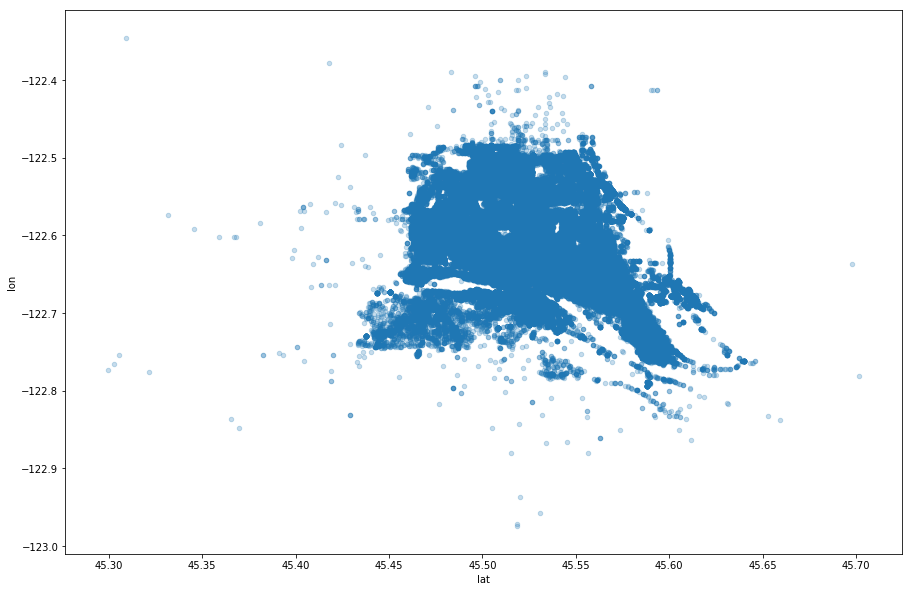

In [19]:
df[['lat', 'lon']].plot.scatter('lat', 'lon', alpha=0.25, figsize=(15, 10))

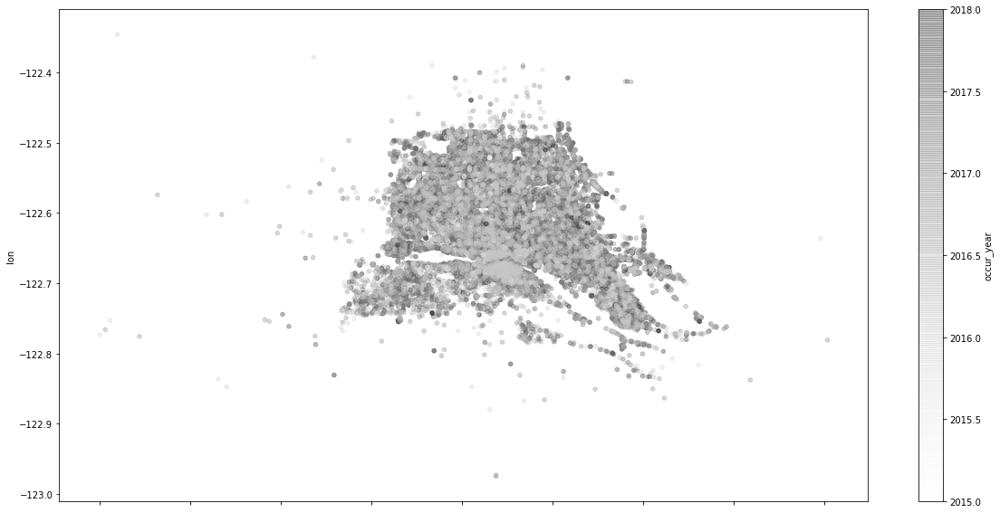

In [20]:
#df.plot.scatter(x='a', y='b', c='c', s=50);
df[['lat', 'lon', 'occur_year']].plot.scatter('lat', 'lon', alpha=0.25, c='occur_year', figsize=(20, 10))

In [21]:
# call it darkwing, in honor of darkwing duck

# action items
'''
1. find data sets for other major cities
2. put them into a spreadsheet
3. find hosting
4. throw this into a local mysql for quick dev
'''

'\n1. find data sets for other major cities\n2. put them into a spreadsheet\n3. find hosting\n4. throw this into a local mysql for quick dev\n'

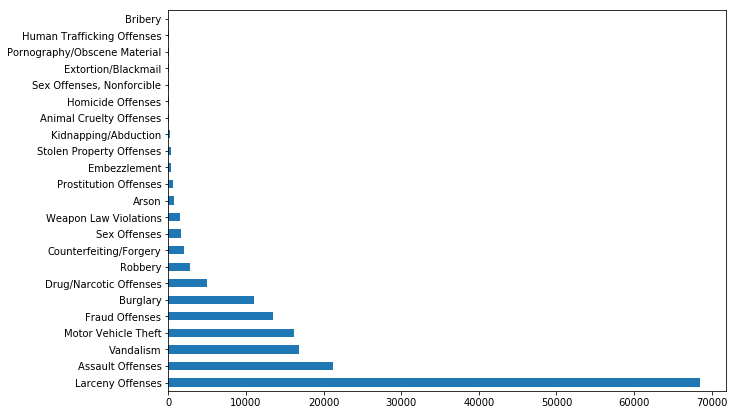

In [22]:
df['offense_category'].value_counts().plot.barh(figsize=(10, 7))

In [23]:
offense = df[df['offense_category']=='Drug/Narcotic Offenses']
offense.head(3)

,crime_against,neighborhood,offense_category,offense_type,lat,lon,x,y,occur_month,occur_day,occur_year,occur_time
226,Society,Old Town/Chinatown,Drug/Narcotic Offenses,Drug/Narcotic Violations,45.524545,-122.673439,7645136.0,684827.0,12,1,2017,923
650,Society,Hazelwood,Drug/Narcotic Offenses,Drug/Narcotic Violations,45.533495,-122.560405,7674179.0,687330.0,7,1,2015,2159
718,Society,Powellhurst-Gilbert,Drug/Narcotic Offenses,Drug/Narcotic Violations,45.486762,-122.538349,7679399.0,670153.0,6,1,2015,819


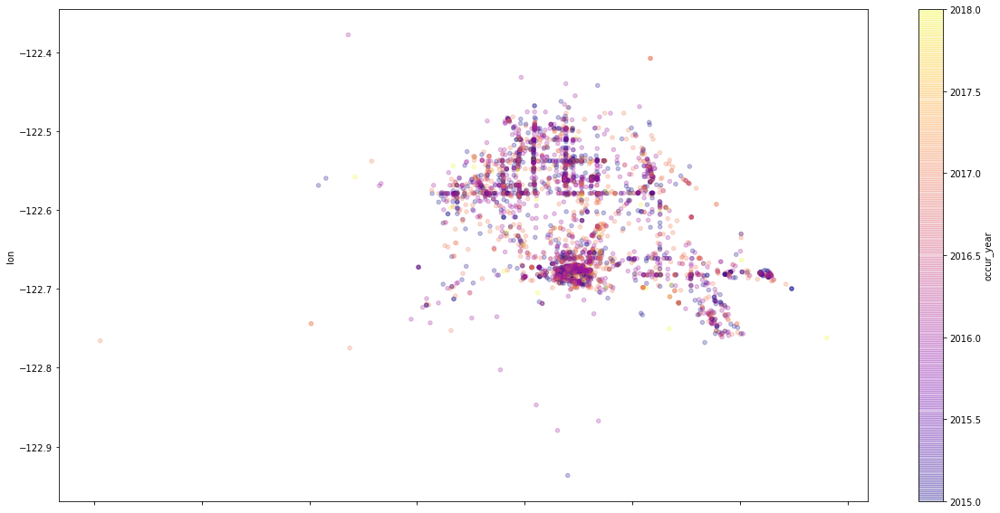

In [24]:
offense[['lat', 'lon', 'occur_year']].plot.scatter('lat', 'lon', alpha=0.25, c='occur_year', figsize=(20, 10), cmap='plasma')

In [25]:
offense = df[df['offense_category']=='Assault Offenses']
offense.head(3)

,crime_against,neighborhood,offense_category,offense_type,lat,lon,x,y,occur_month,occur_day,occur_year,occur_time
0,Person,Mill Park,Assault Offenses,Simple Assault,45.516734,-122.532365,7681208.0,681039.0,10,1,2016,829
1,Person,Buckman West,Assault Offenses,Simple Assault,45.514014,-122.658644,7648824.0,680887.0,10,1,2016,1113
2,Person,Brooklyn,Assault Offenses,Aggravated Assault,45.490331,-122.654233,7649724.0,672225.0,10,1,2016,20


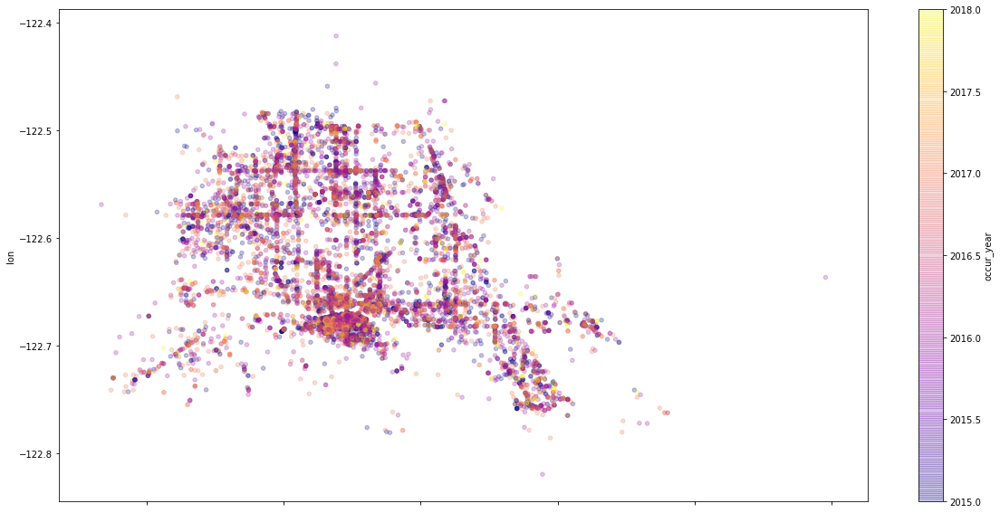

In [26]:
offense[['lat', 'lon', 'occur_year']].plot.scatter('lat', 'lon', alpha=0.25, c='occur_year', figsize=(20, 10), cmap='plasma')

In [27]:
offense['offense_type'].value_counts()

Simple Assault        10095
Intimidation           6096
Aggravated Assault     5015
Name: offense_type, dtype: int64

In [28]:
pvt.head(25)

occur_year,2015,2016,2017,2018,total
neighborhood,,,,,
Downtown,2703.0,3935.0,4052.0,321.0,11011.0
Hazelwood,2684.0,3987.0,3845.0,336.0,10852.0
Lents,1497.0,2179.0,2235.0,189.0,6100.0
Powellhurst-Gilbert,1429.0,2133.0,2247.0,183.0,5992.0
Centennial,1288.0,1931.0,1970.0,223.0,5412.0
Old Town/Chinatown,1309.0,1731.0,2081.0,171.0,5292.0
Northwest,1258.0,1828.0,1795.0,169.0,5050.0
Montavilla,1007.0,1471.0,1673.0,162.0,4313.0
Pearl,1112.0,1298.0,1662.0,145.0,4217.0


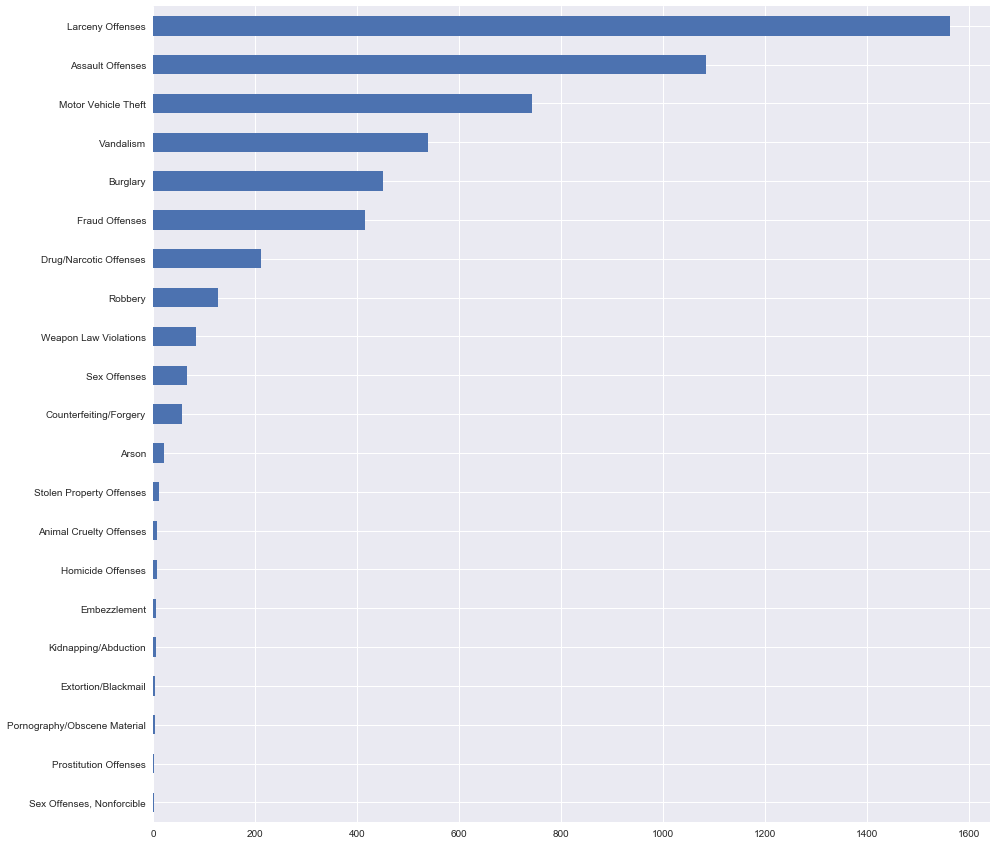

In [198]:
nh = df[df['neighborhood']=='Centennial']
nh['offense_category'].value_counts().plot.barh()
plt.gca().invert_yaxis()

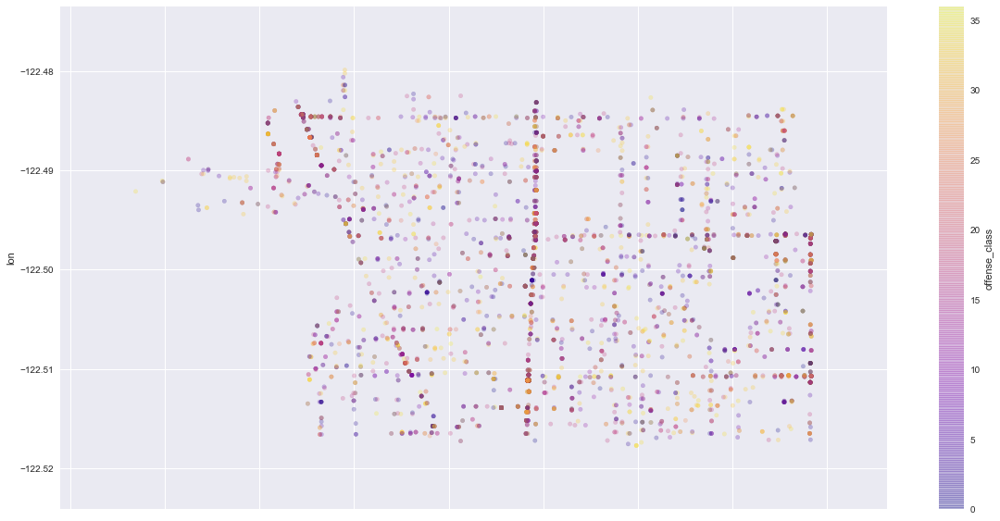

In [199]:
columns = ['offense_type', 'lat', 'lon', 'occur_month']
nh = nh[columns]

from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()

unique = nh['offense_type'].unique()
le_fitted = le.fit(unique)

col_values = list(nh['offense_type'].values)
transformed = le.transform(col_values)

nh['offense_class'] = transformed

nh[['lat', 'lon', 'offense_class']].plot.scatter('lat', 'lon', alpha=0.25, c='offense_class', figsize=(20, 10), cmap='plasma')

In [200]:
nhc = nh.copy()
nhc['lat'] = nh['lat'].round(5)
nhc['lon'] = nh['lon'].round(5)
agg = nhc.groupby(by=['offense_class', 'occur_month', 'lat', 'lon']).agg('count')
agg = agg.reset_index().sort_values(by='offense_type', ascending=False)

agg = agg[['lat', 'lon', 'offense_class', 'offense_type']]
agg.columns = ['lat', 'lon', 'offense_class', 'offense_count']

agg.head(3)

,lat,lon,offense_class,offense_count
2548,45.50417,-122.51116,25,13
2478,45.49267,-122.48670,25,13
2531,45.50417,-122.51116,25,12


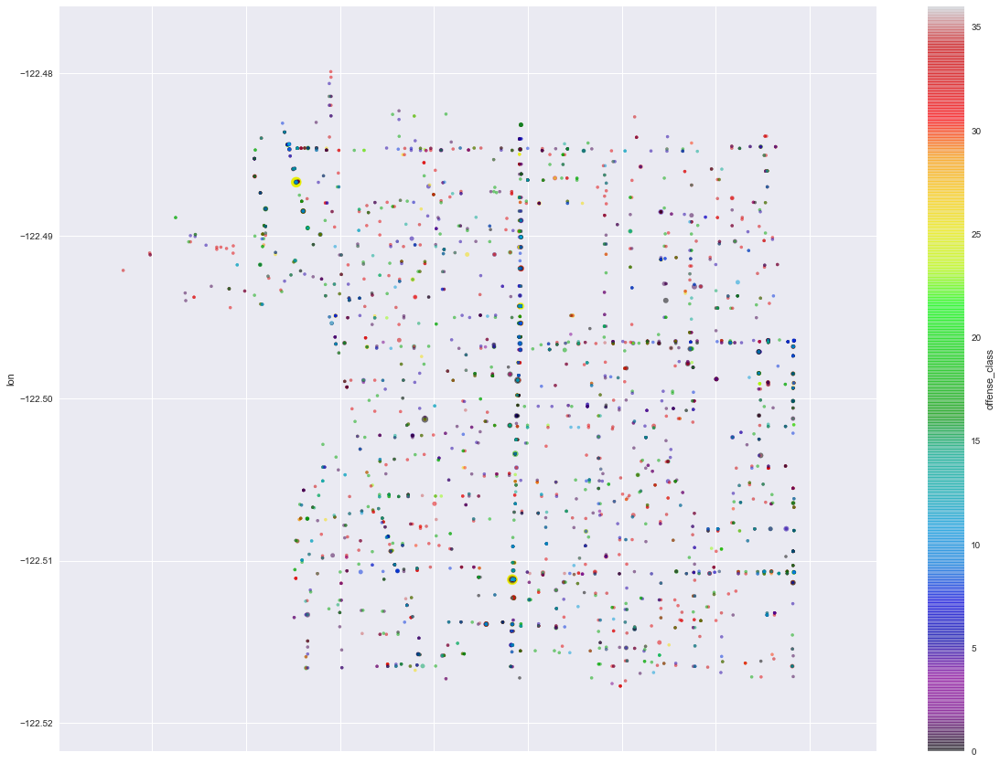

In [201]:
# get it to show location and category as title
counts = agg['offense_count'] * 10 # used for dot sizes
agg.plot.scatter('lat', 'lon', c='offense_class', alpha=0.5, s=counts.as_matrix(), figsize=(20, 15), cmap='nipy_spectral')

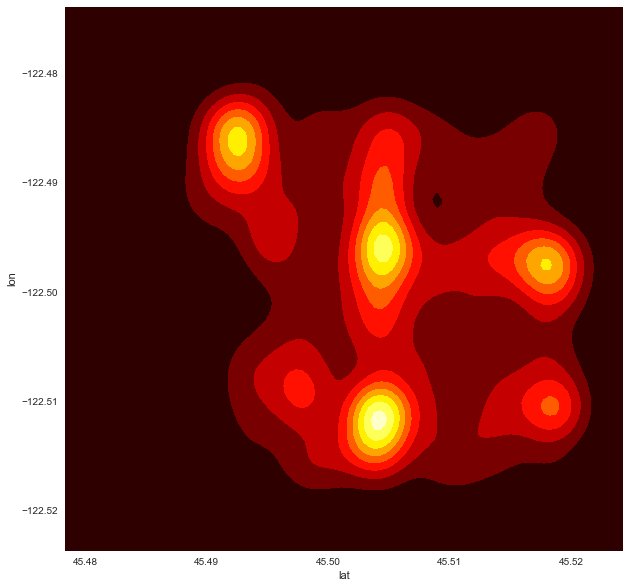

In [203]:
sns.set(rc={'figure.figsize':(10,10)})
sns.kdeplot(agg['lat'], agg['lon'], shade=True, cmap='hot', legend=True)

In [197]:
offense_key = nh[['offense_type', 'offense_class']].drop_duplicates().sort_values(by='offense_class')
offense_key.head(3)

,offense_type,offense_class
21,Aggravated Assault,0
151,All Other Larceny,1
18326,Animal Cruelty,2


In [34]:
def plot_crime_category_by_nh_and_hour(neighborhood, offense_category):
    nh = df[df['neighborhood']==neighborhood]
    nh = nh[nh['offense_category']==offense_category]

    nh = nh.sort_values(by=['occur_year', 'occur_month', 'occur_day', 'occur_time'])
    columns = ['offense_type', 'occur_time']
    nh = nh[columns]

    # investigate offense_type by hour
    labels = range(0,24,1)
    nh['bin'] = pd.cut(nh['occur_time'], bins=range(0, 2500, 100), labels=labels)
    nh['bin'] = nh['bin'].fillna(0)

    nagg = nh.groupby(by=['offense_type', 'bin']).agg('count')
    res = nagg.reset_index()
    res.columns = ['offense_type', 'occur_hour', 'instances']

    pvt = pd.pivot_table(res, values='instances', index='offense_type', columns='occur_hour')
    pvt = pvt.T

    pvt = pvt.fillna(0)

    if not pvt.empty:
        title = neighborhood + " - " + offense_category
        pvt.plot.area(figsize=(20, 6), rot=45, stacked=True, title=title, alpha=0.5)
        #pvt.plot(figsize=(20, 6), rot=45, title=title)

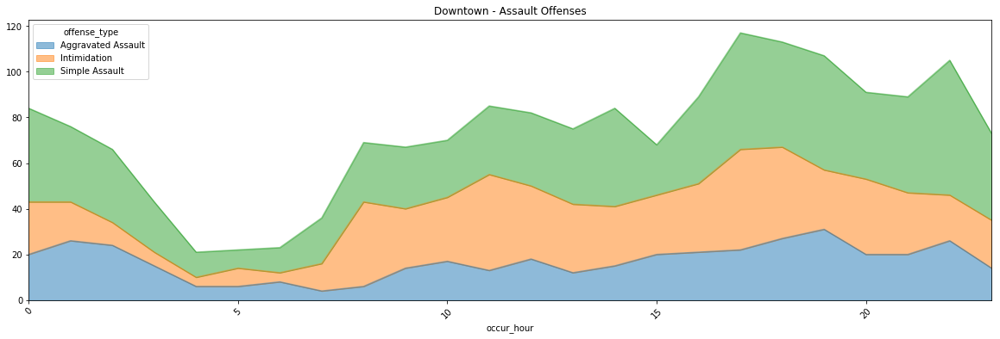

In [72]:
plot_crime_category_by_nh_and_hour('Downtown', 'Assault Offenses')

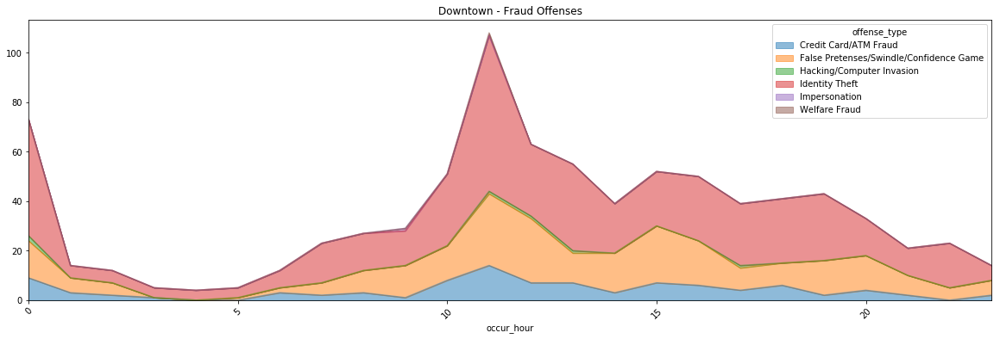

In [36]:
plot_crime_category_by_nh_and_hour('Downtown', 'Fraud Offenses')

In [79]:
path = r'C:\Users\groov\PythonCode\data\PortlandCrime\PortlandNeighborhoods.csv'
unique_neighborhoods = df['neighborhood'].sort_values().unique()
pd.DataFrame({'neighborhood': unique_neighborhoods}).set_index('neighborhood').to_csv(path)

In [38]:
unique_offense_categories = df['offense_category'].sort_values().unique()
unique_offense_categories
#idea: what is the top5 neighborhoods for each of these, then maybe publish

array(['Animal Cruelty Offenses', 'Arson', 'Assault Offenses', 'Bribery',
       'Burglary', 'Counterfeiting/Forgery', 'Drug/Narcotic Offenses',
       'Embezzlement', 'Extortion/Blackmail', 'Fraud Offenses',
       'Homicide Offenses', 'Human Trafficking Offenses',
       'Kidnapping/Abduction', 'Larceny Offenses', 'Motor Vehicle Theft',
       'Pornography/Obscene Material', 'Prostitution Offenses', 'Robbery',
       'Sex Offenses', 'Sex Offenses, Nonforcible',
       'Stolen Property Offenses', 'Vandalism', 'Weapon Law Violations'], dtype=object)

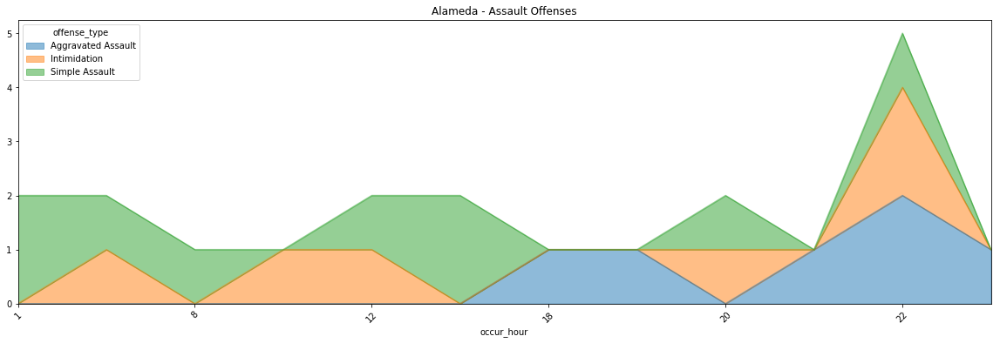

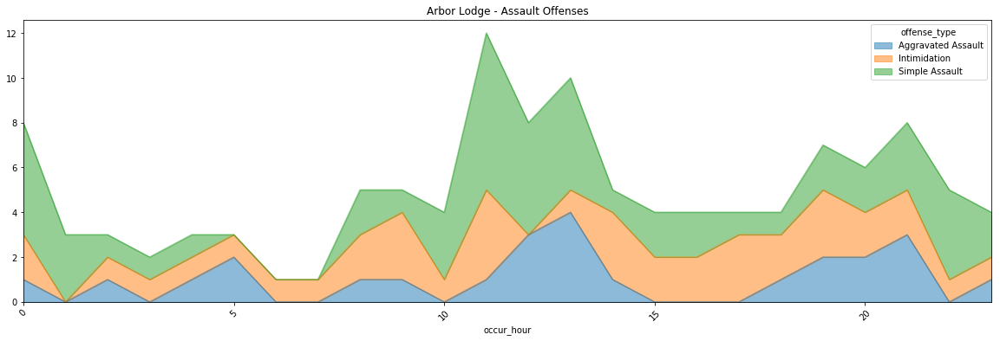

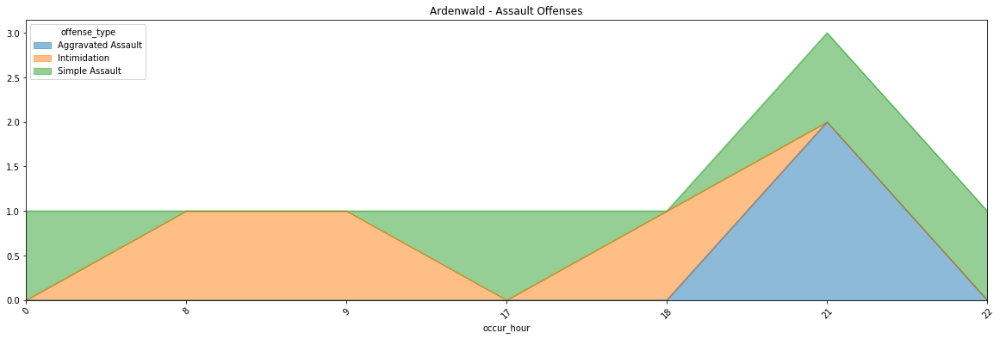

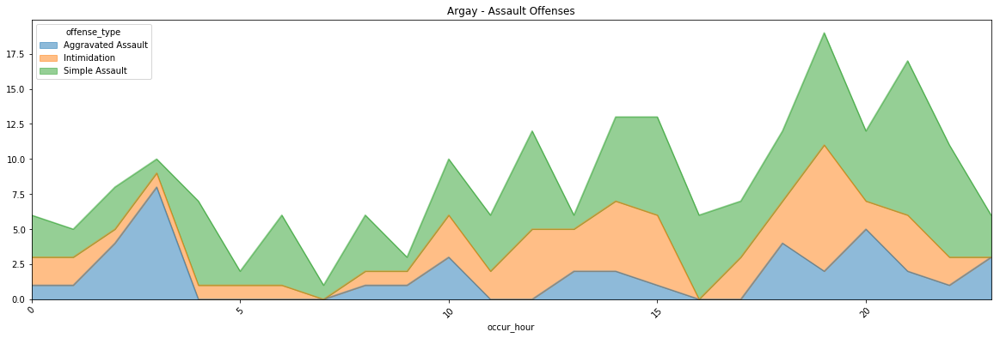

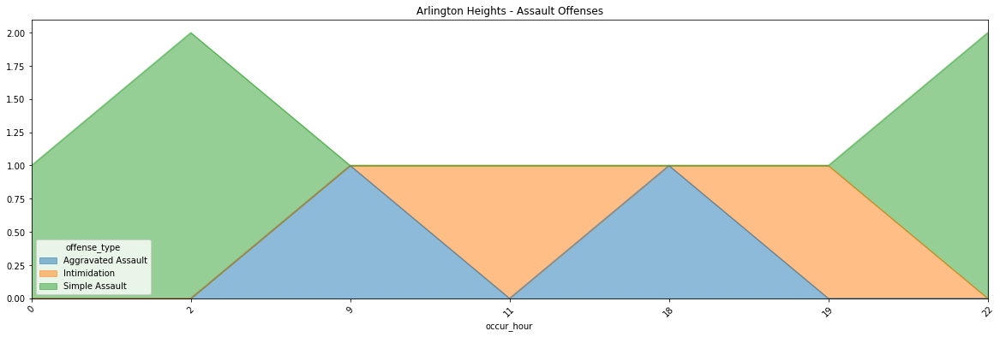

...

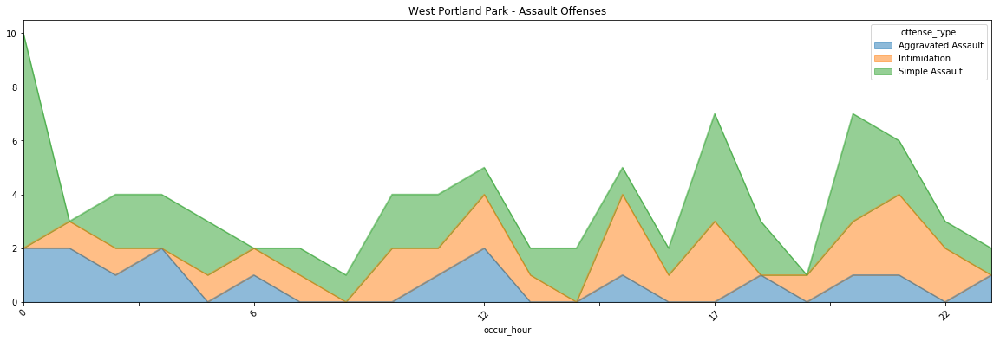

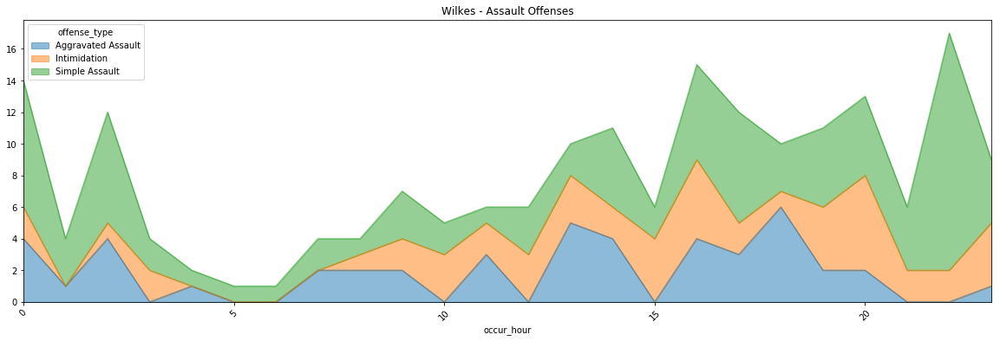

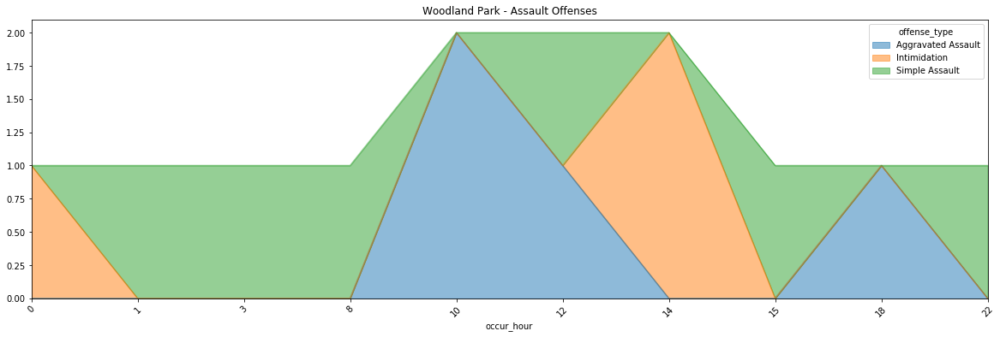

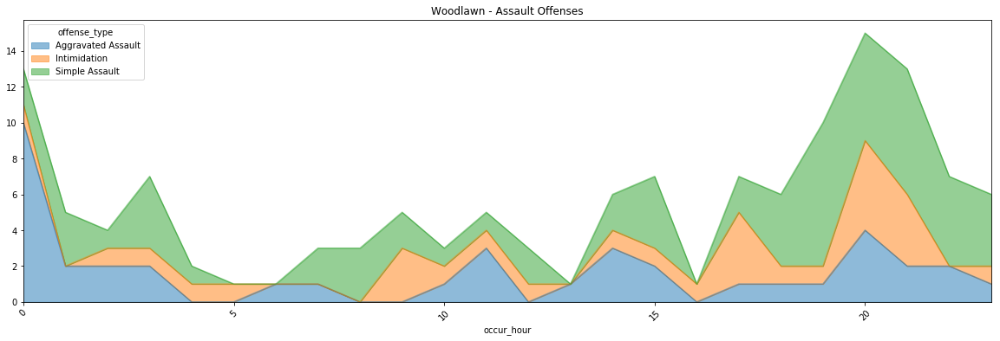

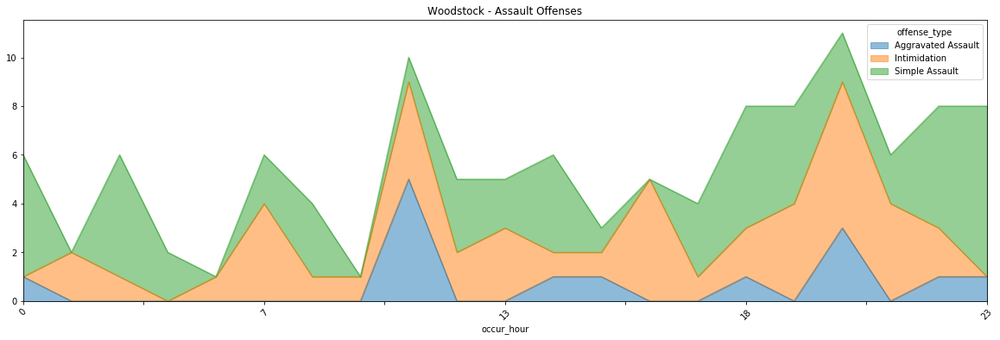

In [39]:
for n in unique_neighborhoods:
    plot_crime_category_by_nh_and_hour(n, 'Assault Offenses')

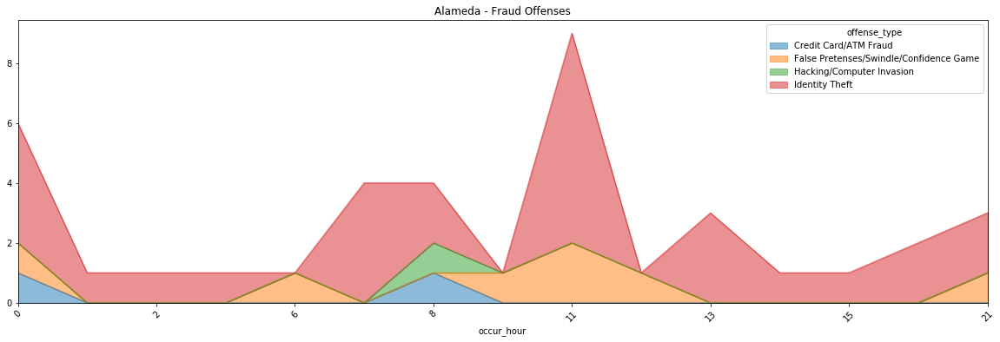

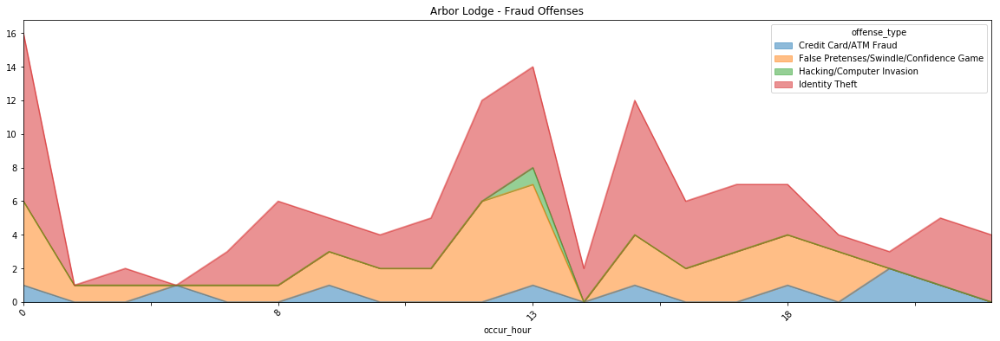

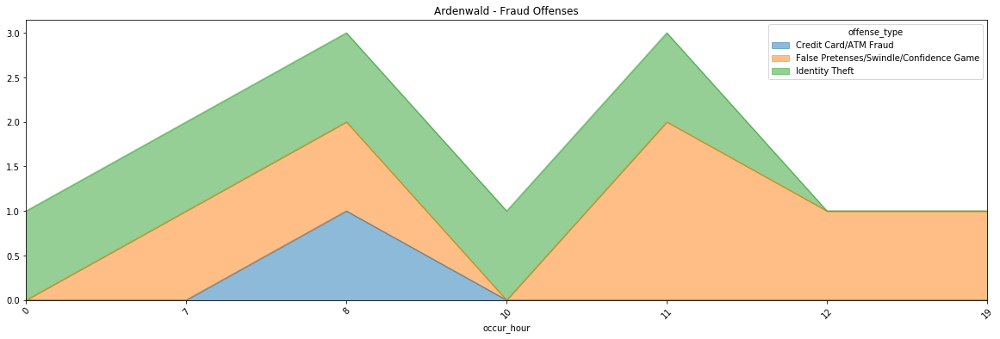

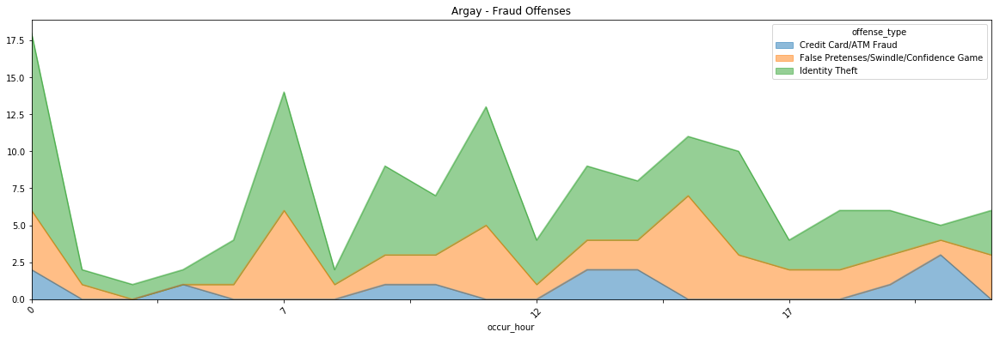

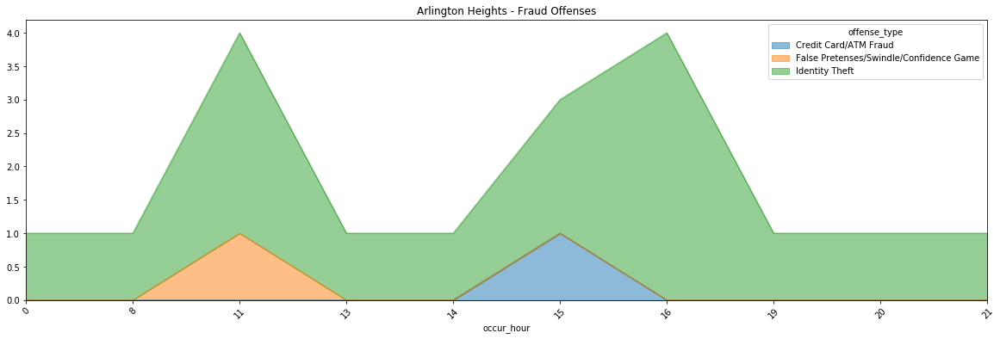

...

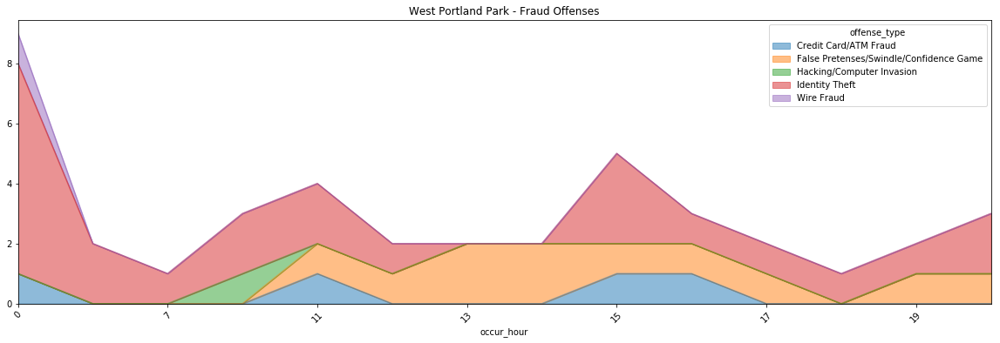

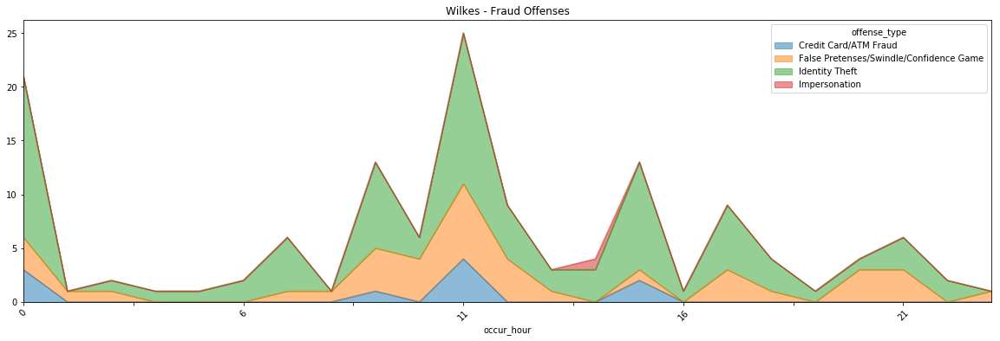

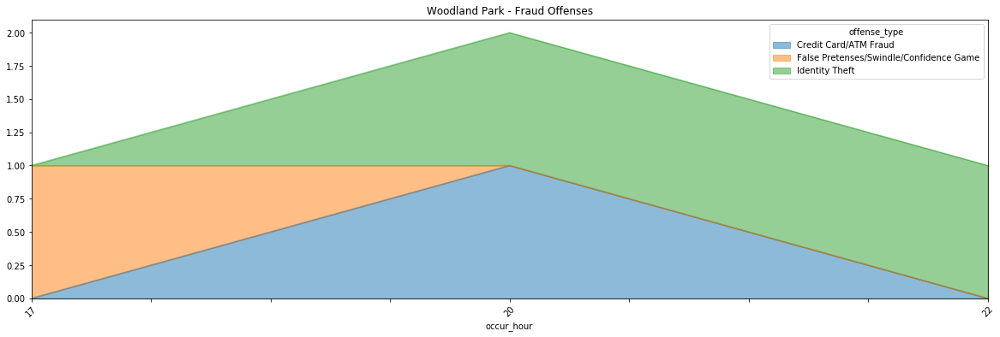

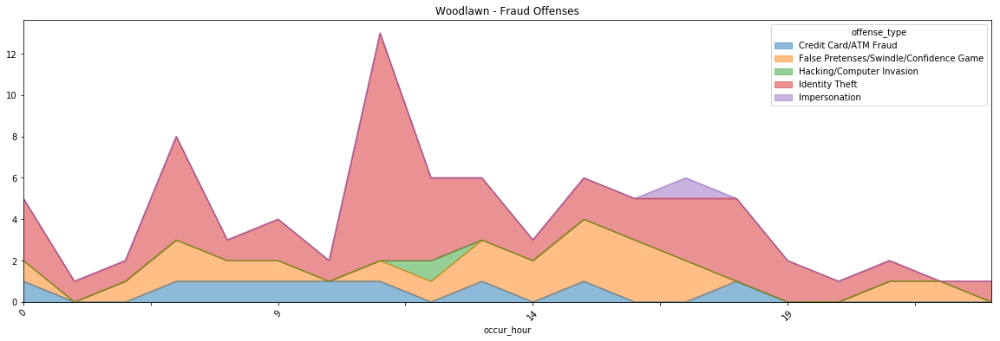

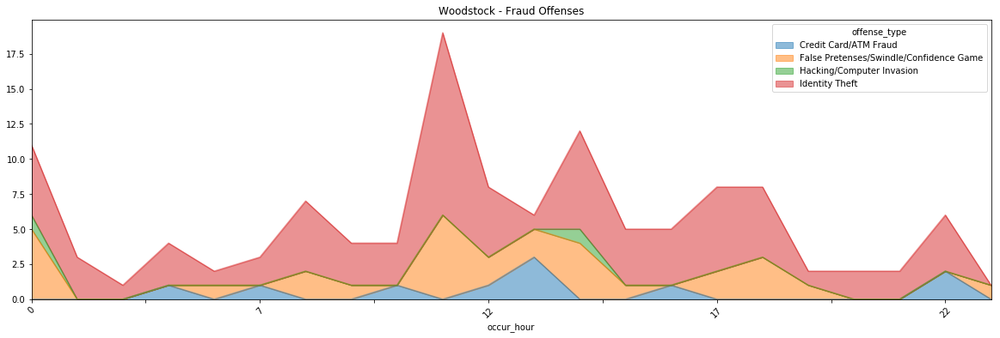

In [40]:
for n in unique_neighborhoods:
    plot_crime_category_by_nh_and_hour(n, 'Fraud Offenses')

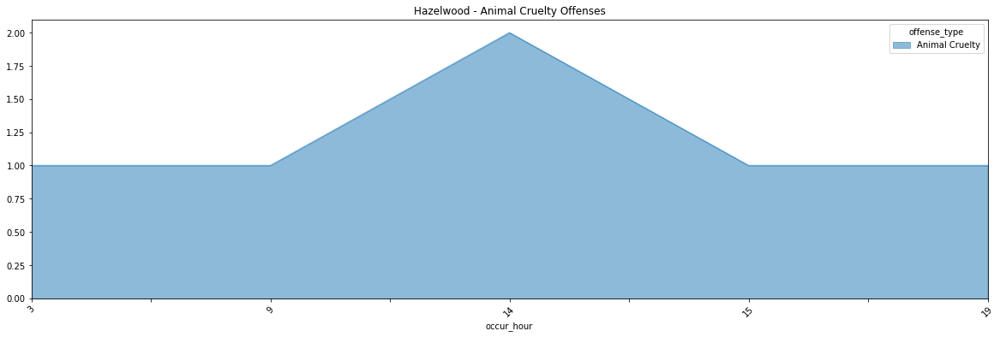

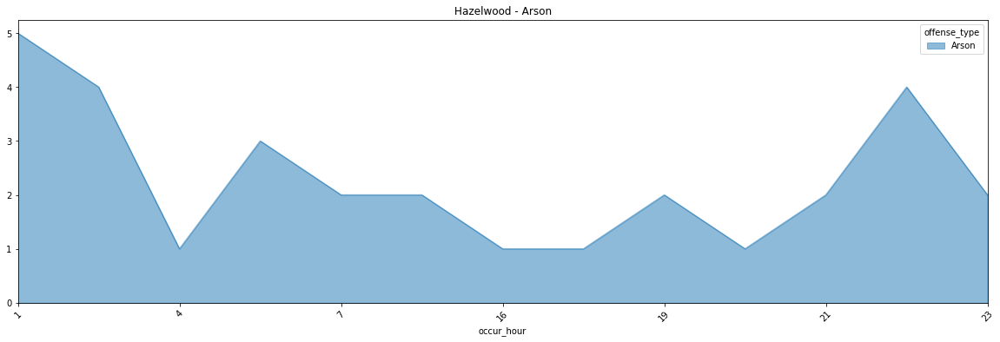

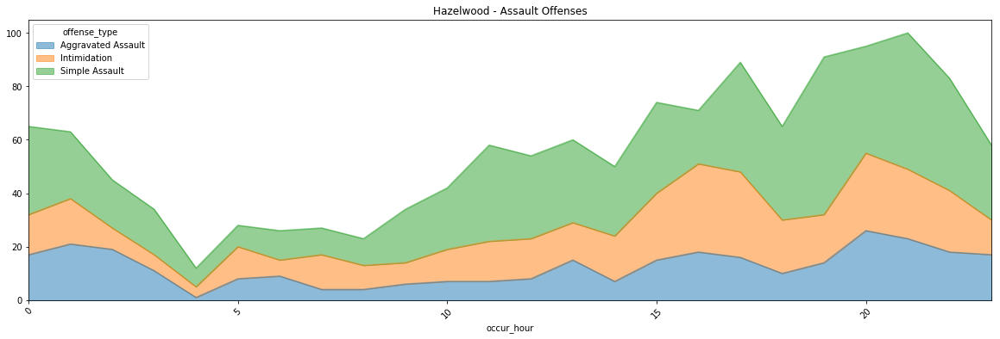

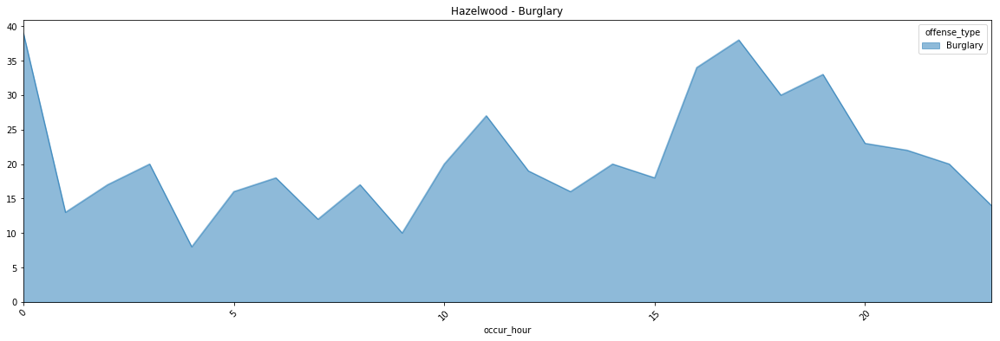

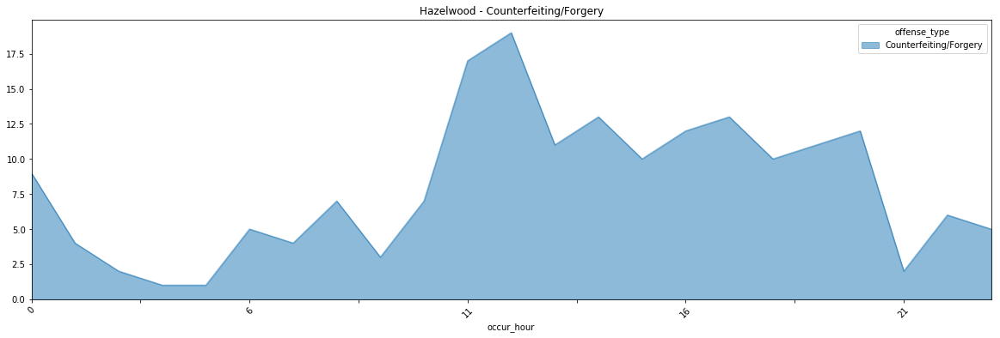

...

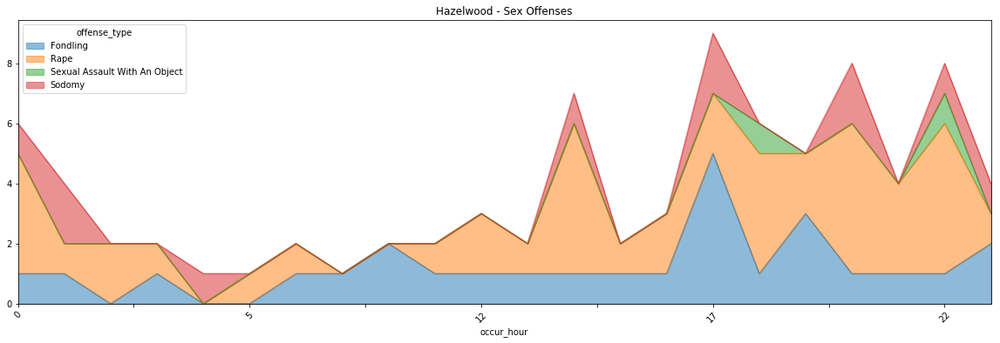

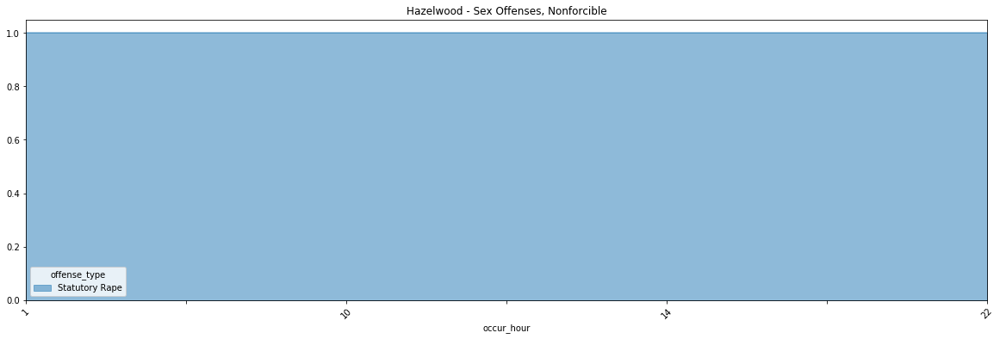

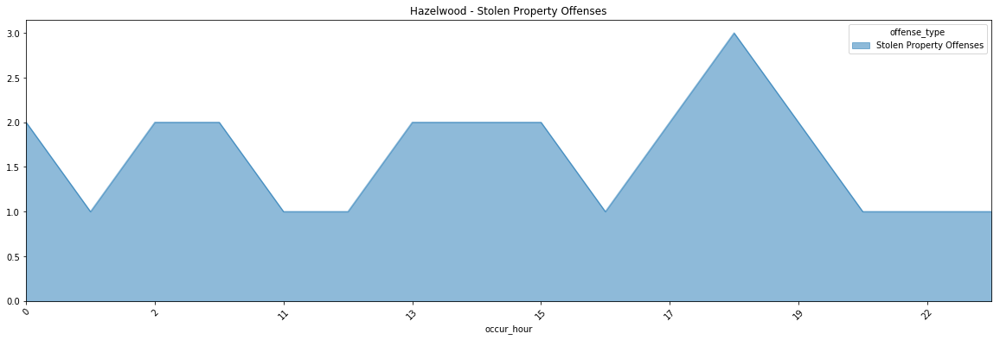

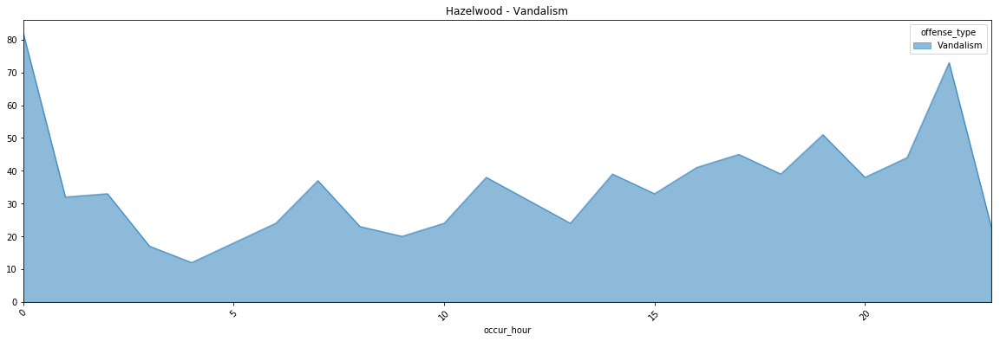

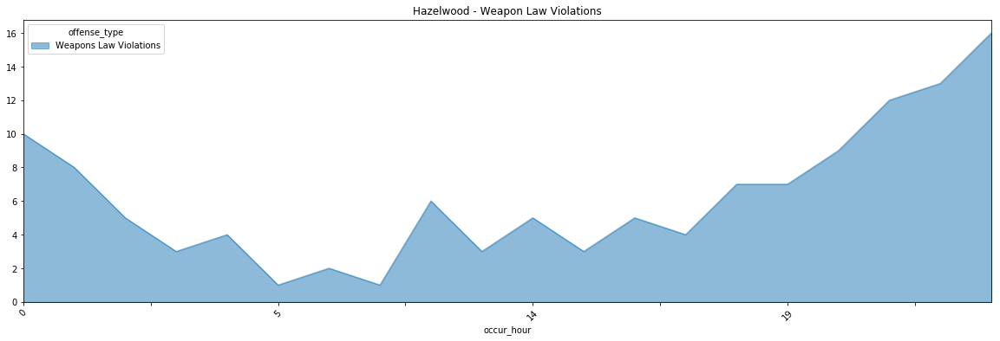

In [41]:
for c in unique_offense_categories:
    plot_crime_category_by_nh_and_hour('Hazelwood', c)

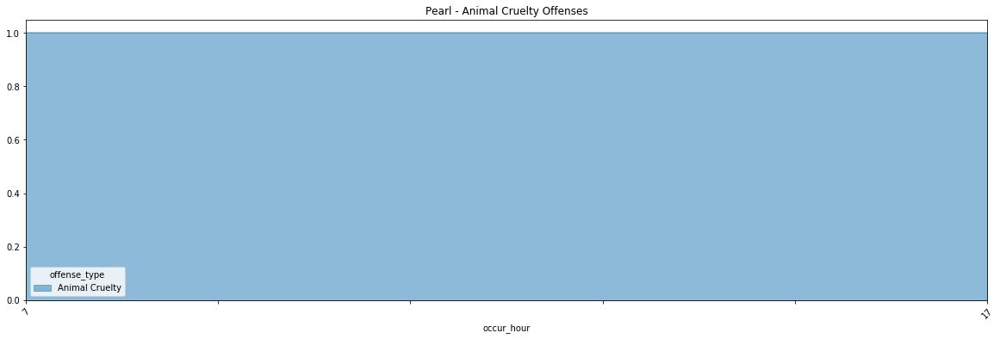

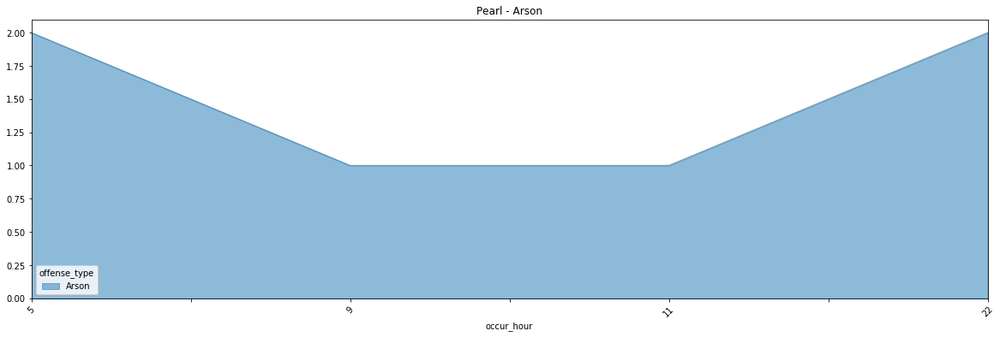

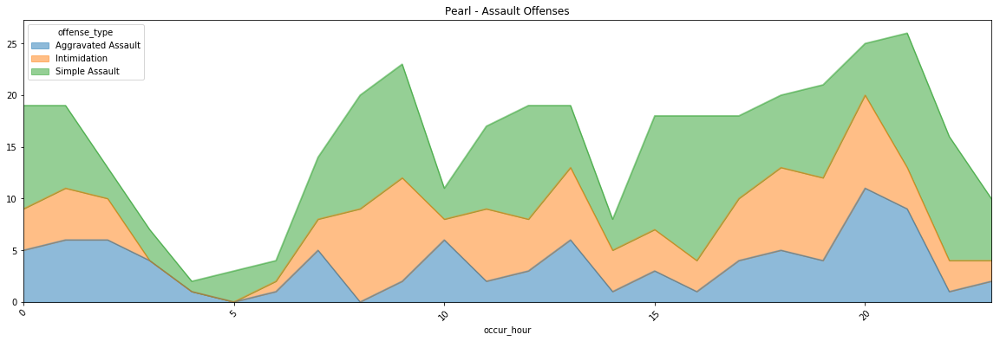

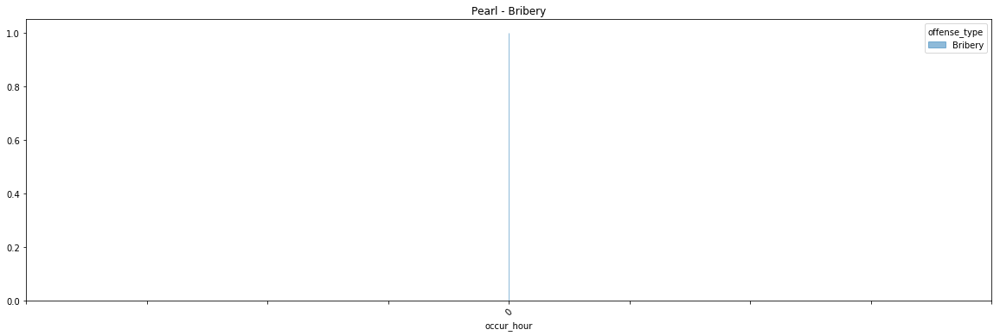

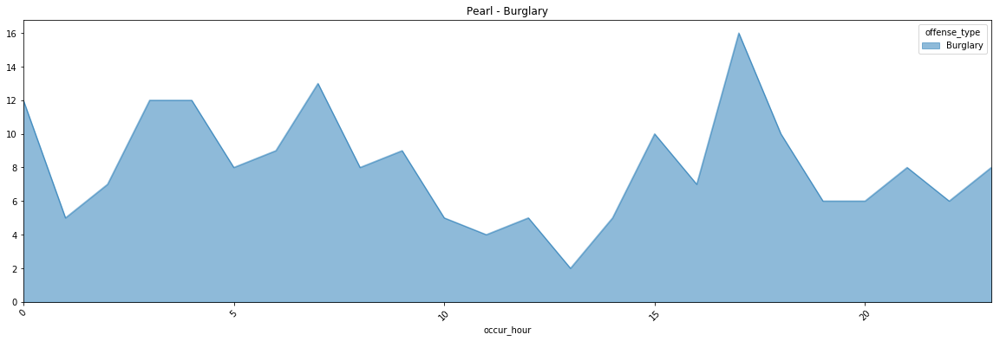

...

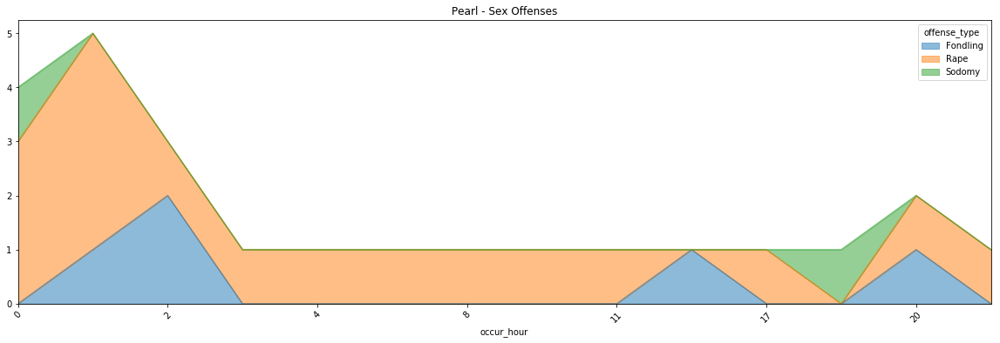

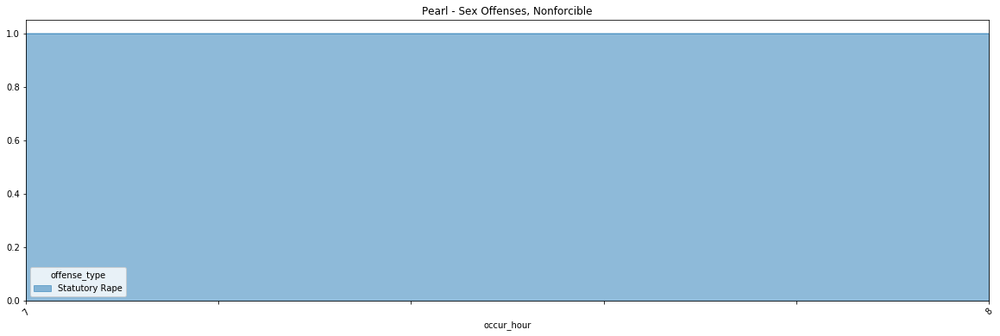

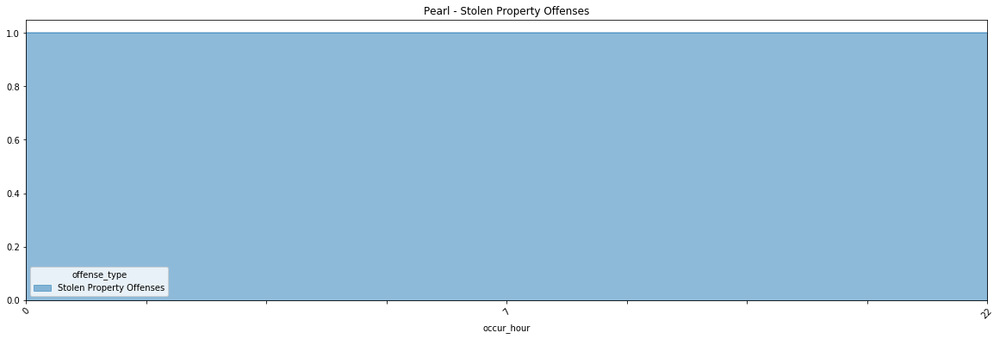

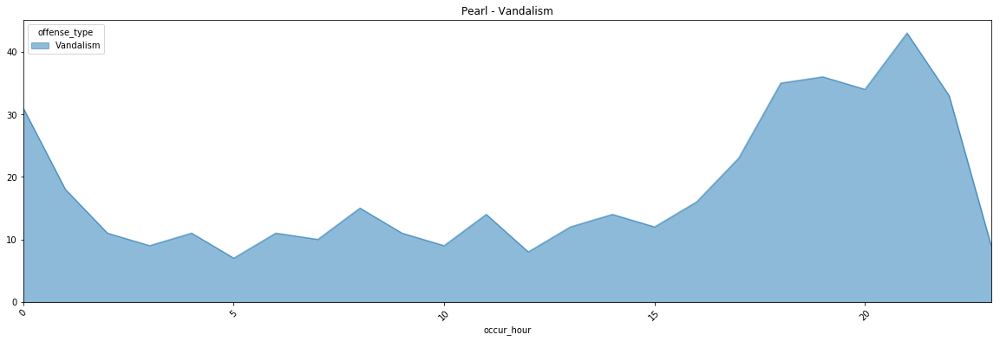

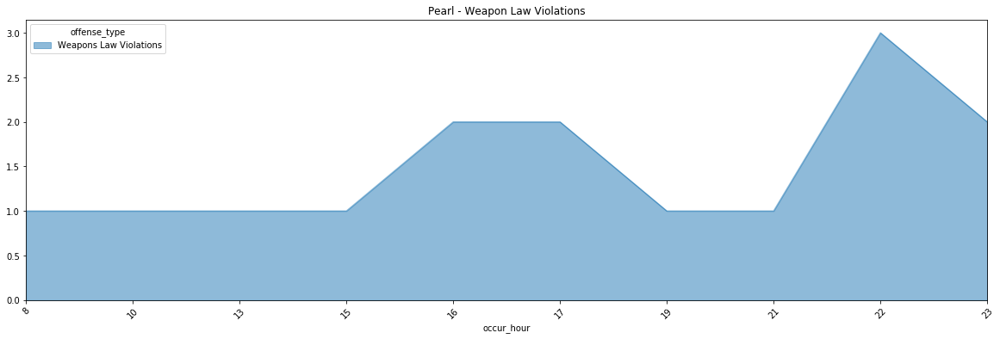

In [42]:
for c in unique_offense_categories:
    plot_crime_category_by_nh_and_hour('Pearl', c)

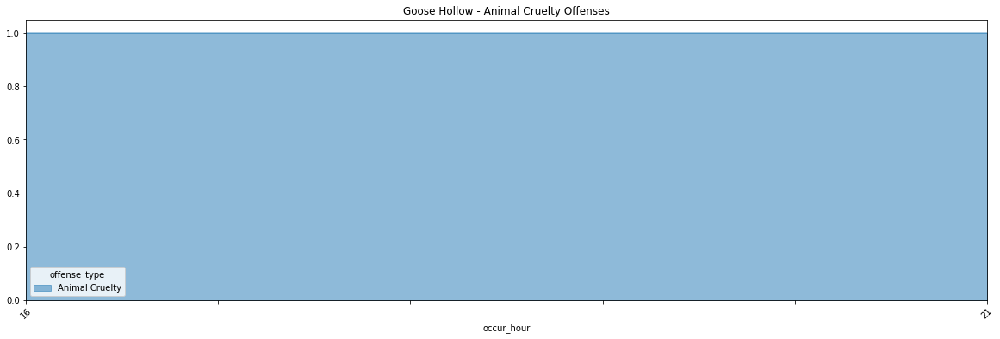

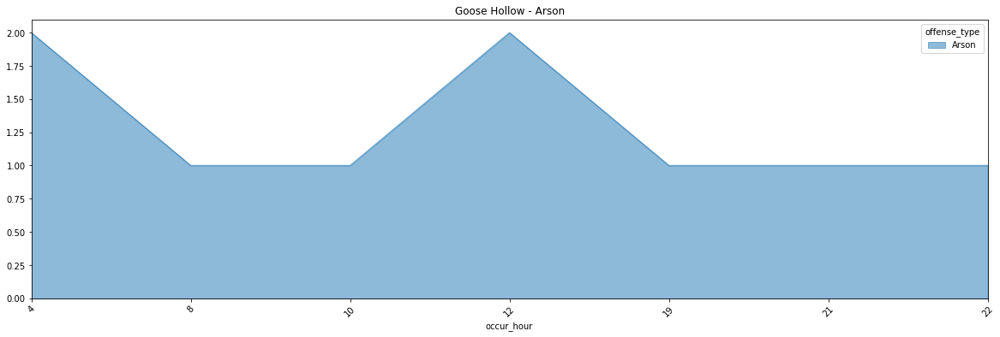

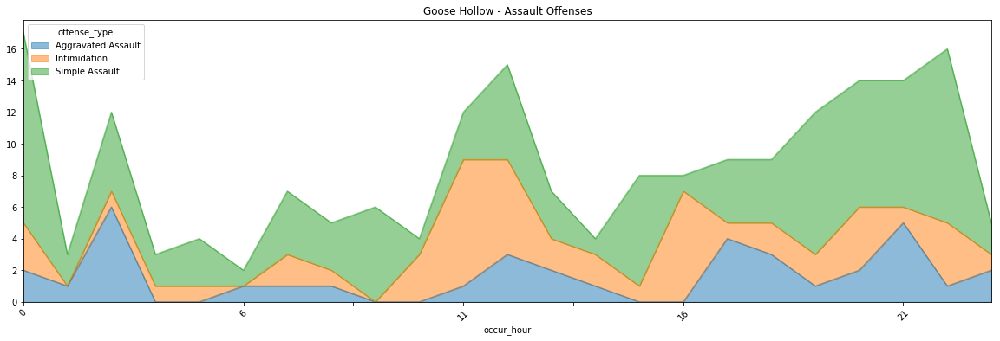

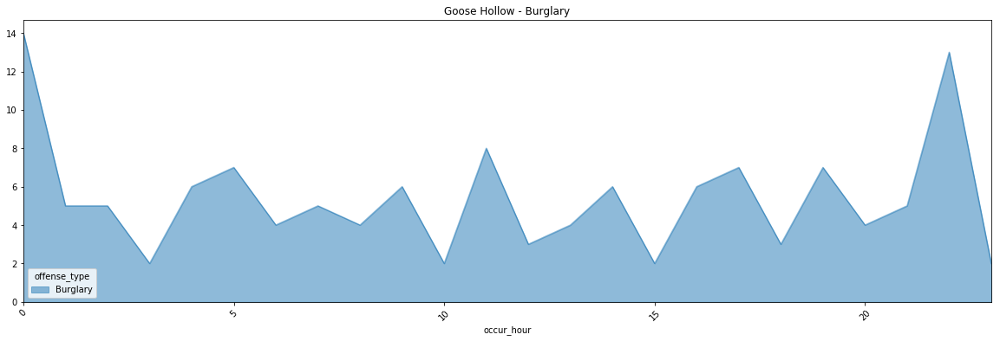

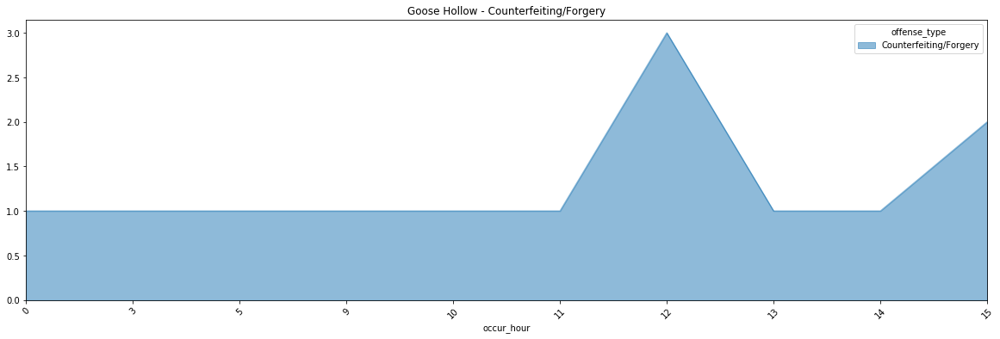

...

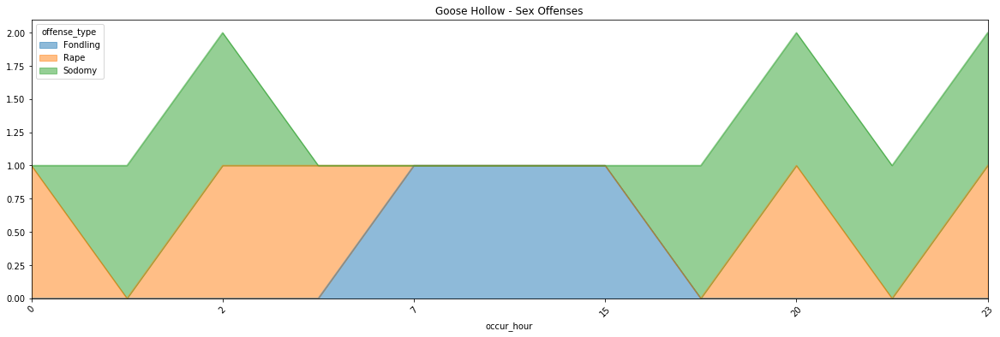

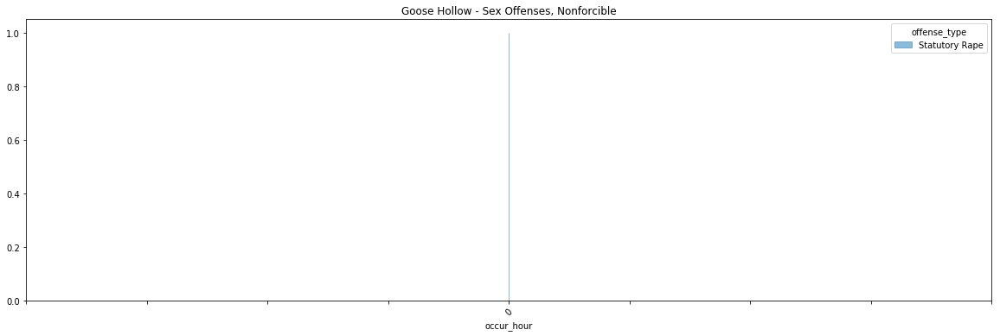

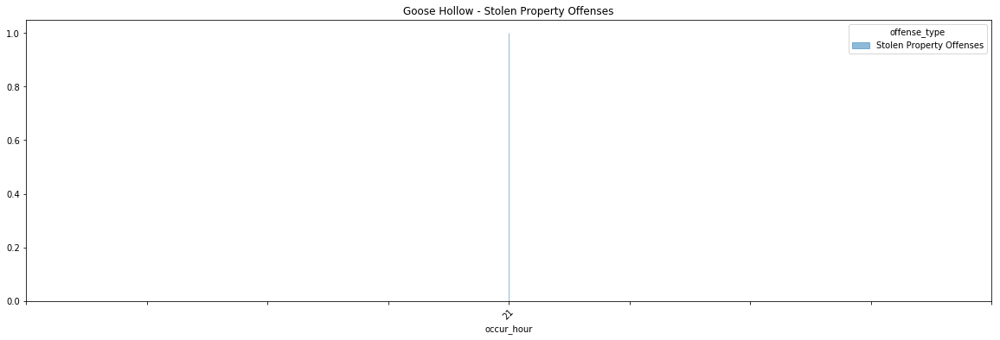

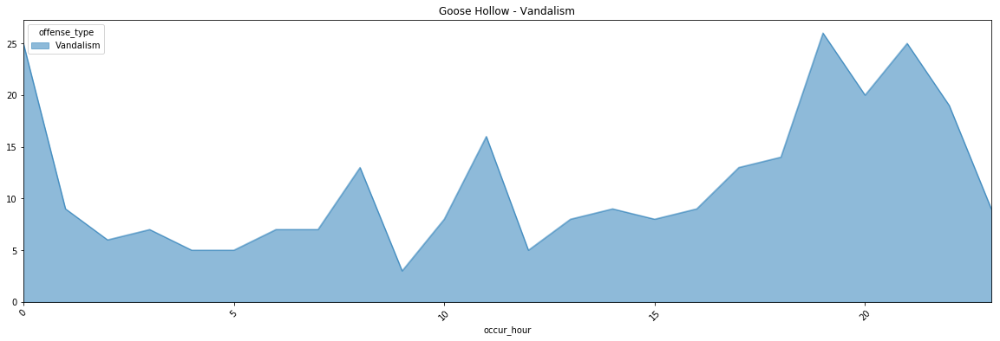

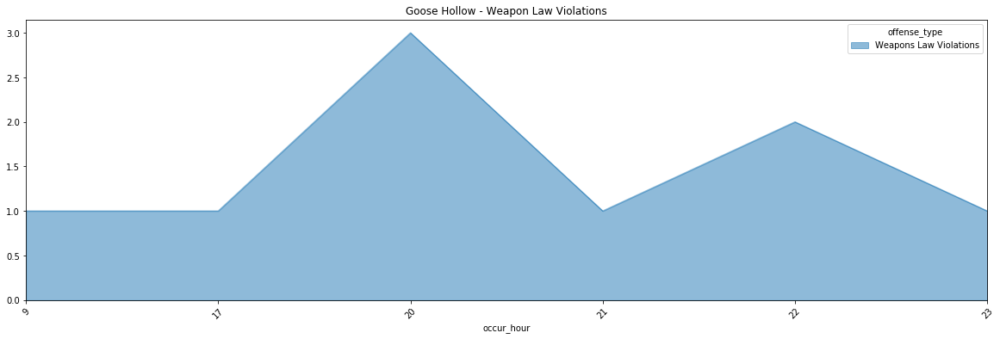

In [43]:
for c in unique_offense_categories:
    plot_crime_category_by_nh_and_hour('Goose Hollow', c)

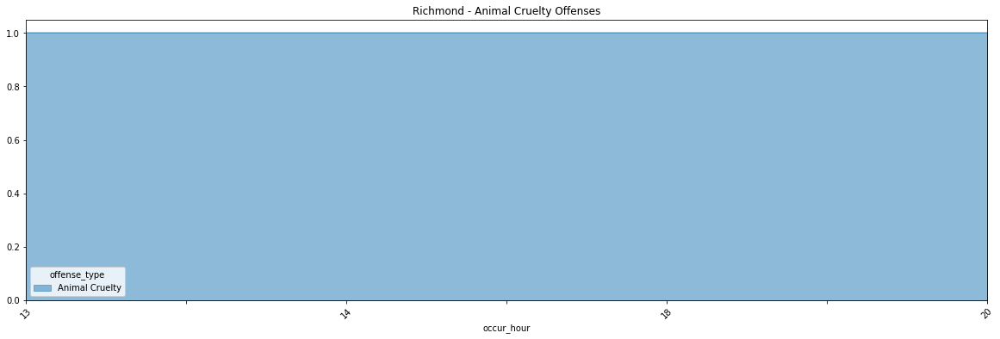

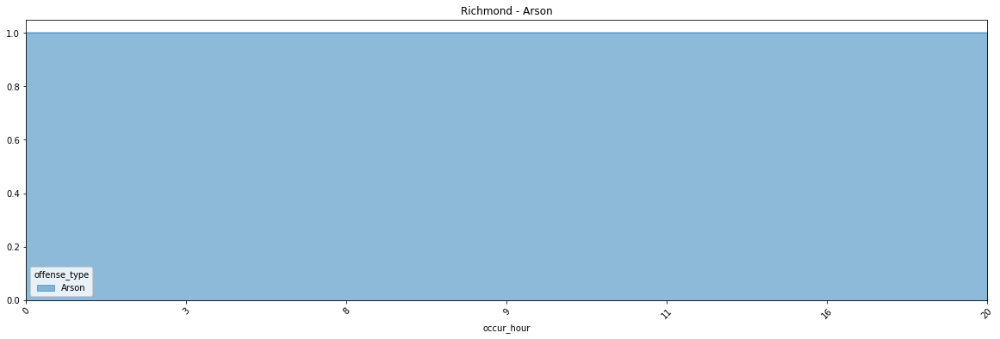

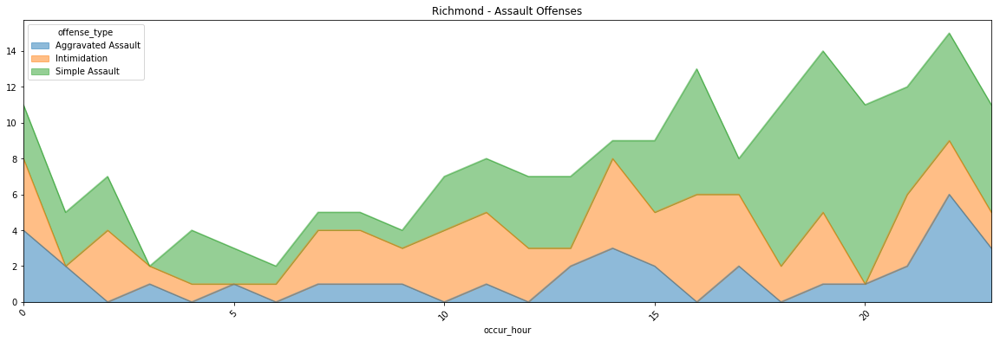

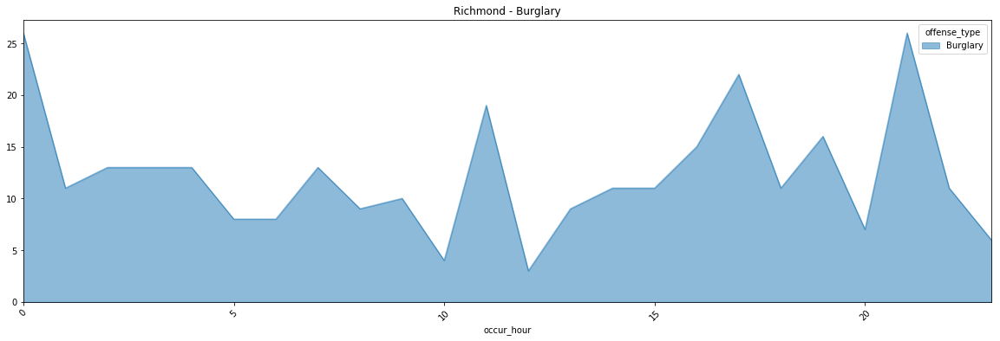

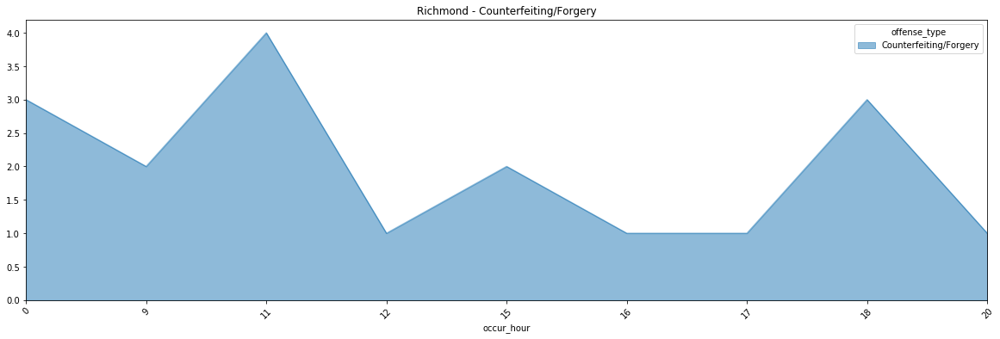

...

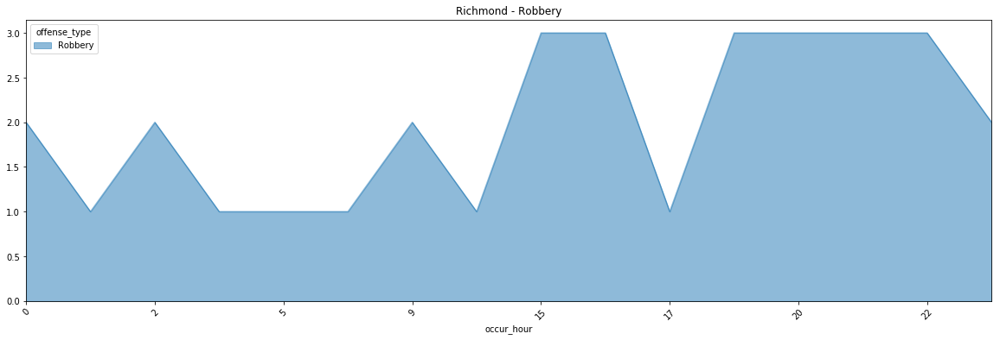

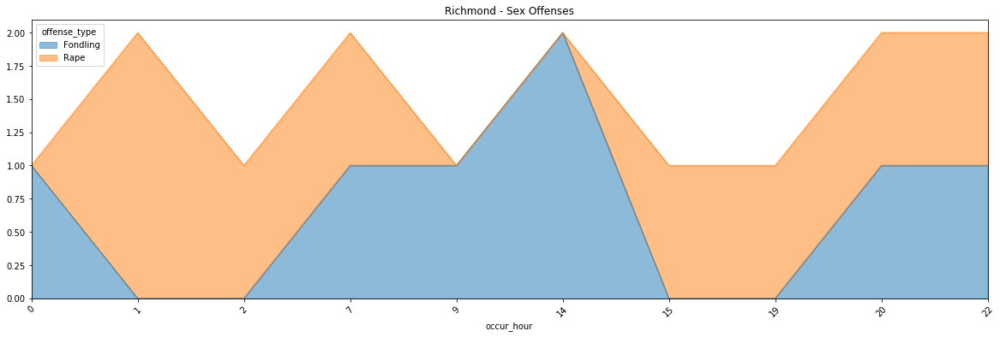

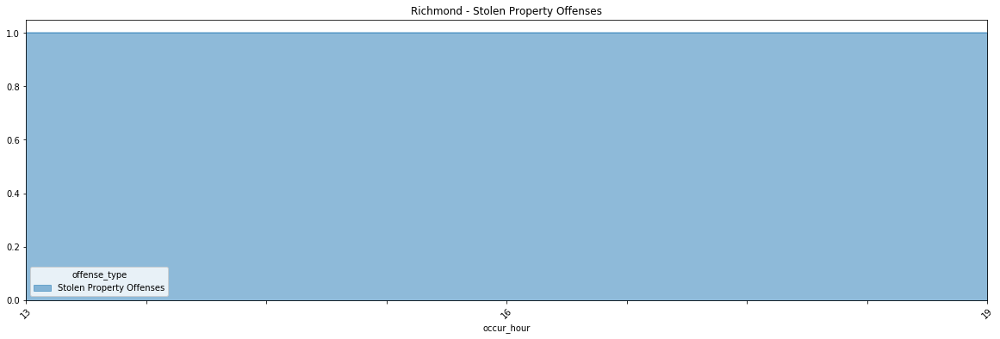

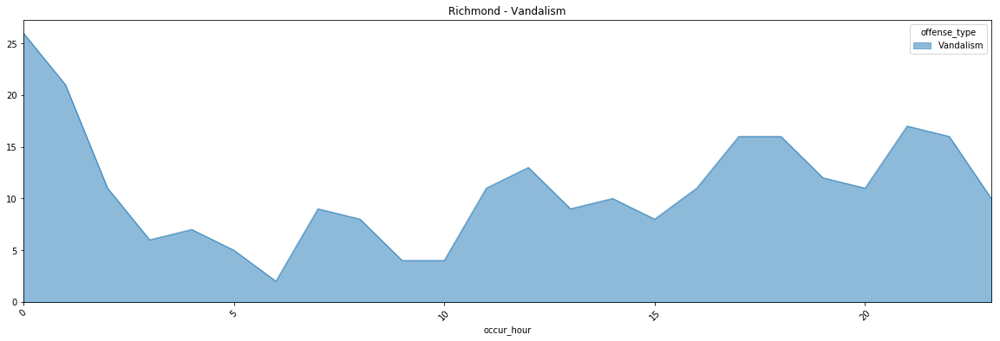

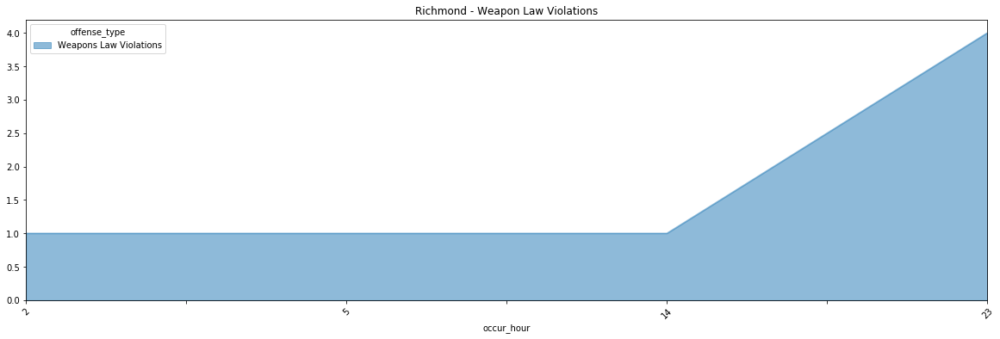

In [44]:
for c in unique_offense_categories:
    plot_crime_category_by_nh_and_hour('Richmond', c)

In [45]:
# this really needs to be posted as an article or blog
df.head(3)

,crime_against,neighborhood,offense_category,offense_type,lat,lon,x,y,occur_month,occur_day,occur_year,occur_time
0,Person,Mill Park,Assault Offenses,Simple Assault,45.516734,-122.532365,7681208.0,681039.0,10,1,2016,829
1,Person,Buckman West,Assault Offenses,Simple Assault,45.514014,-122.658644,7648824.0,680887.0,10,1,2016,1113
2,Person,Brooklyn,Assault Offenses,Aggravated Assault,45.490331,-122.654233,7649724.0,672225.0,10,1,2016,20


In [46]:
cby = df[['occur_year', 'neighborhood', 'crime_against']]
cby = cby[cby['occur_year'] > 2014]
cby = cby[cby['occur_year'] < 2018]
agg = cby.groupby(by=['occur_year', 'neighborhood']).agg('count')
agg.reset_index(inplace=True)

agg.columns = ['occur_year', 'neighborhood', 'crime_count']
agg.set_index('neighborhood', inplace=True)
#agg.sort_values(by='crime_count', ascending=False, inplace=True) # not needed

pvt = pd.pivot_table(agg, values='crime_count', index='neighborhood', columns='occur_year')
pvt['crime_total'] = pvt.sum(axis=1)

pvt.sort_values(by='crime_total', ascending=False, inplace=True)

pvt.head(3)

occur_year,2015,2016,2017,crime_total
neighborhood,,,,
Downtown,2703,3935,4052,10690
Hazelwood,2684,3987,3845,10516
Lents,1497,2179,2235,5911


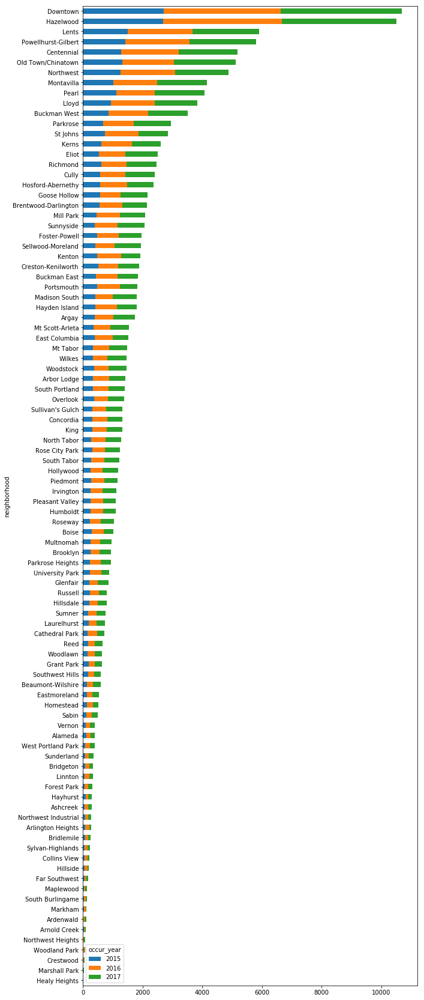

In [47]:
pvt[[2015, 2016, 2017]].plot.barh(figsize=(10, 30), stacked=True)
plt.gca().invert_yaxis()

In [50]:
summary = pvt.copy()
summary['2015cmp'] = (pvt[2015] / pvt[2015].sum()) * 100
summary['2016cmp'] = (pvt[2016] / pvt[2016].sum()) * 100
summary['2017cmp'] = (pvt[2017] / pvt[2017].sum()) * 100

t2015 = summary['2015cmp']
t2016 = summary['2016cmp']
t2017 = summary['2017cmp']

change2016 = ((t2016 - t2015) / t2015) * 100
change2017 = ((t2017 - t2015) / t2015) * 100

summary['change2016'] = change2016
summary['change2017'] = change2017
summary.head(3)

occur_year,2015,2016,2017,crime_total,2015cmp,2016cmp,2017cmp,change2016,change2017
neighborhood,,,,,,,,,
Downtown,2703,3935,4052,10690,7.206463,7.046289,6.839280,-2.222641,-5.095181
Hazelwood,2684,3987,3845,10516,7.155807,7.139404,6.489890,-0.229227,-9.305969
Lents,1497,2179,2235,5911,3.991149,3.901871,3.772407,-2.236883,-5.480677


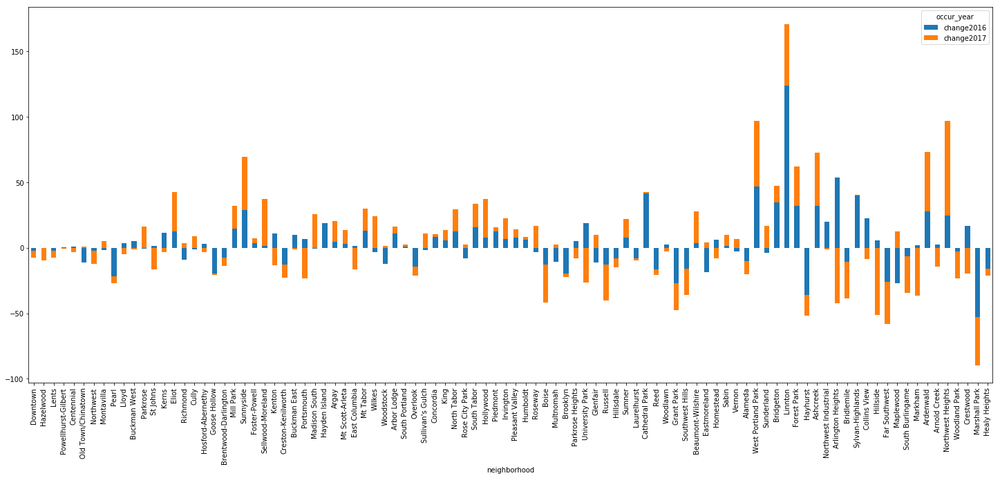

In [51]:
# crime growth by neighborhood
change = summary[['change2016', 'change2017']]
change.plot.bar(figsize=(25, 10), stacked=True)

In [52]:
change['change_mean'] = change.mean(axis=1)
crime_increases = change[change['change_mean'] > 0]
crime_decreases = change[change['change_mean'] < 0]
crime_increases.sort_values(by='change_mean', ascending=False, inplace=True)
crime_decreases.sort_values(by='change_mean', ascending=True, inplace=True)
crime_increases.drop('change_mean', axis=1, inplace=True)
crime_decreases.drop('change_mean', axis=1, inplace=True)

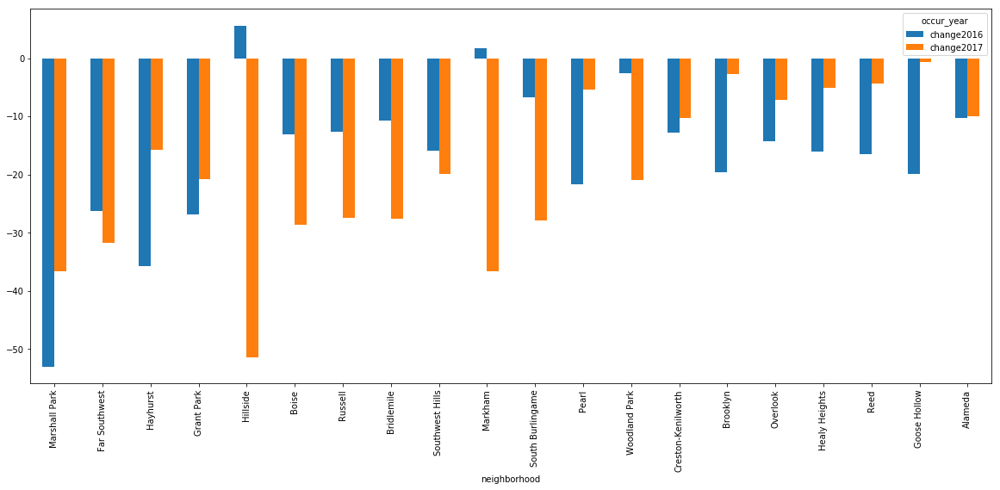

In [53]:
# it's looking better, but huge growth often is a sign that these are low-crime areas
crime_decreases[0:20].plot.bar(figsize=(20,8))

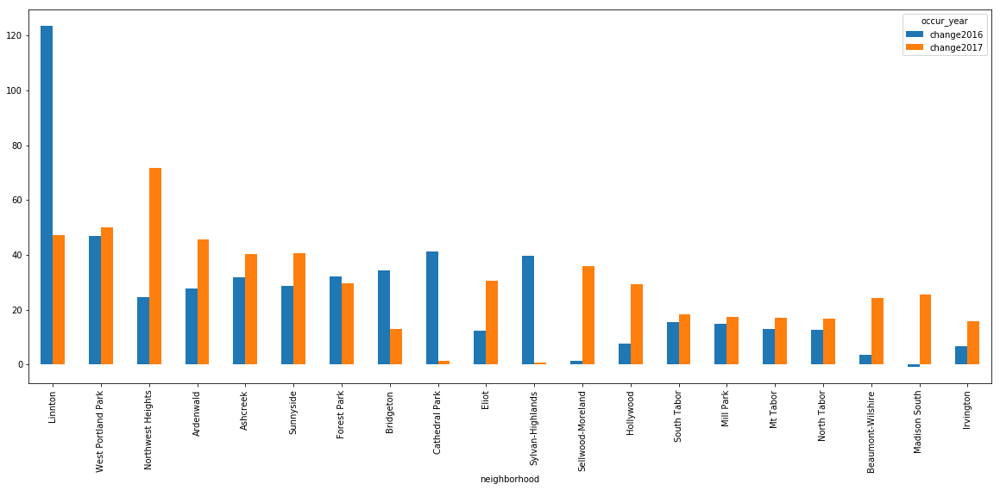

In [54]:
# it's looking worse, but huge growth often is a sign that these are low-crime areas
crime_increases[0:20].plot.bar(figsize=(20,8))

In [55]:
# can random forest predict crime class based on lat, lon, time, month, day?
X = df[['lat', 'lon', 'occur_time', 'occur_month', 'occur_day', 'offense_type']]
#X = df[['lat', 'lon', 'occur_time', 'occur_month', 'offense_type', 'offense_category']]
#X = X[X['offense_category']=='Larceny Offenses'] # this is kind of cheating, though
#X = X.drop('offense_category', axis=1)

from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()

unique = X['offense_type'].unique()
le_fitted = le.fit(unique)

col_values = list(X['offense_type'].values)
transformed = le.transform(col_values)

X['offense_class'] = transformed

X.drop('offense_type', axis=1, inplace=True)
X.dropna(how='any', inplace=True)

y = X['offense_class'].as_matrix()
X.drop('offense_class', axis=1, inplace=True)

X.head(3)

,lat,lon,occur_time,occur_month,occur_day
0,45.516734,-122.532365,829,10,1
1,45.514014,-122.658644,1113,10,1
2,45.490331,-122.654233,20,10,1


In [56]:
print("X: {}, Y: {}".format(X.shape, y.shape))

X: (145057, 5), Y: (145057,)


In [57]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=1337)
X_train.head()

,lat,lon,occur_time,occur_month,occur_day
90134,45.526097,-122.641351,500,7,1
6680,45.595515,-122.678637,1112,7,1
59478,45.518998,-122.535155,1700,7,1
63607,45.510461,-122.578615,713,11,1
21487,45.521728,-122.539940,2100,7,1


In [58]:
def plot_feature_importances(clf, columns):
    n_features = X.shape[1]
    height = n_features * 1
    width = height * 1.2
    plt.figure(figsize=(width,height))
    plt.barh(range(n_features), clf.feature_importances_, align='center')
    plt.yticks(np.arange(n_features), columns)
    plt.xlabel("Feature importance")
    plt.ylabel("Feature")

In [59]:
from sklearn.ensemble import RandomForestClassifier
forest = RandomForestClassifier(n_estimators=500, random_state=1337, n_jobs=-1, max_features=3, max_depth=7)
forest.fit(X_train, y_train)

print("Accuracy on training set: {:.4f}".format(forest.score(X_train, y_train)))
print("Accuracy on test set: {:.4f}".format(forest.score(X_test, y_test)))

Accuracy on training set: 0.2611
Accuracy on test set: 0.2577


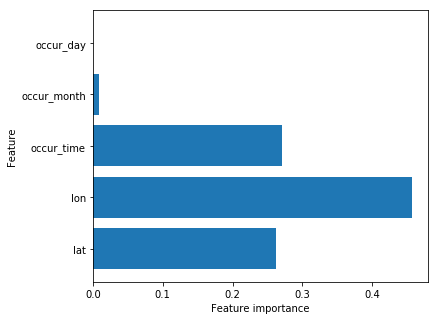

In [60]:
columns = X_train.columns
plot_feature_importances(forest, columns)

In [61]:
from sklearn.neighbors import KNeighborsClassifier
n_neighbors = 20 #optimized value

clf = KNeighborsClassifier(n_neighbors, n_jobs=-1)
clf.fit(X_train, y_train)

print("Accuracy on training set: {:.3f}".format(clf.score(X_train, y_train)))
print("Accuracy on test set: {:.3f}".format(clf.score(X_test, y_test)))

Accuracy on training set: 0.286
Accuracy on test set: 0.212


In [62]:
# svm and gradiant boosted trees will not work without preprocessing probably due to lat/lon

In [141]:
def print_annual_top10_neighborhoods(offense_type):
    offense = df[df['offense_type']==offense_type]

    columns = ['occur_year', 'neighborhood', 'lat']
    group = ['occur_year', 'neighborhood']
    offense = offense[columns]
    offense = offense.groupby(by=group).agg('count')
    offense.reset_index(inplace=True)

    columns = ['occur_year', 'neighborhood', 'crime_count']
    offense.columns = columns

    pvt = pd.pivot_table(offense, values='crime_count', index='neighborhood', columns='occur_year')
    pvt['crime_total'] = pvt.sum(axis=1)
    
    if 2015 in pvt.columns:
        c2015 = pvt.sort_values(by=2015, ascending=False).head(10)
        c2015 = c2015[2015]
        pd.DataFrame(c2015).plot.barh(title=offense_type)
        plt.gca().invert_yaxis()
        
    if 2016 in pvt.columns: 
        c2016 = pvt.sort_values(by=2016, ascending=False).head(10)
        c2016 = c2016[2016]
        pd.DataFrame(c2016).plot.barh(title=offense_type)
        plt.gca().invert_yaxis()
        
    if 2017 in pvt.columns:     
        c2017 = pvt.sort_values(by=2017, ascending=False).head(10)
        c2017 = c2017[2017]
        pd.DataFrame(c2017).plot.barh(title=offense_type)
        plt.gca().invert_yaxis()
        
    if 2018 in pvt.columns:  
        c2018 = pvt.sort_values(by=2018, ascending=False).head(10)
        c2018 = c2018[2018]
        pd.DataFrame(c2018).plot.barh(title=offense_type)
        plt.gca().invert_yaxis()

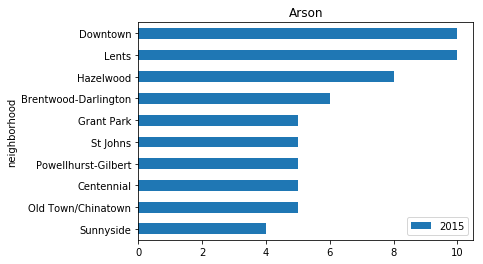

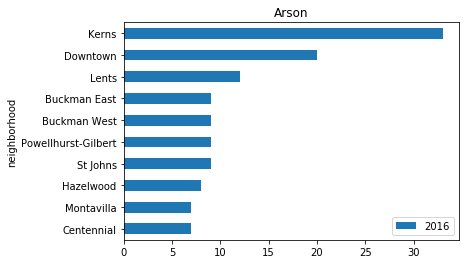

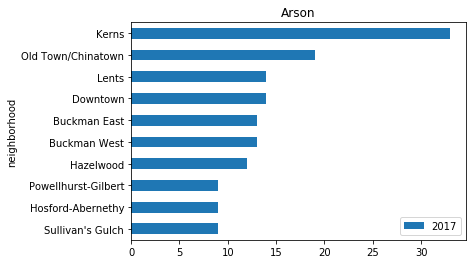

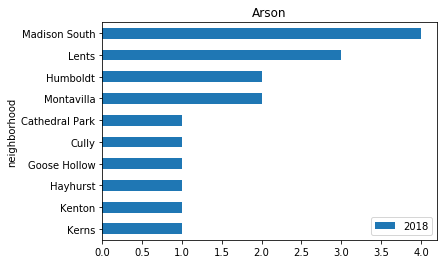

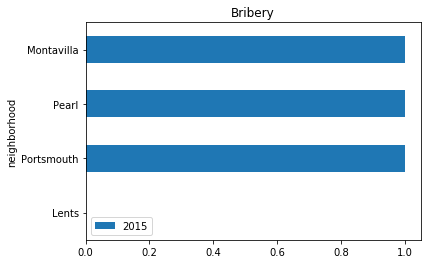

...

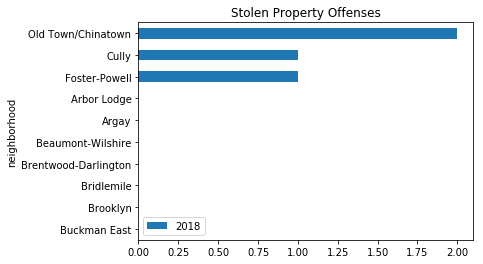

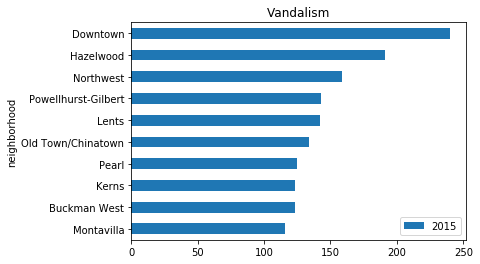

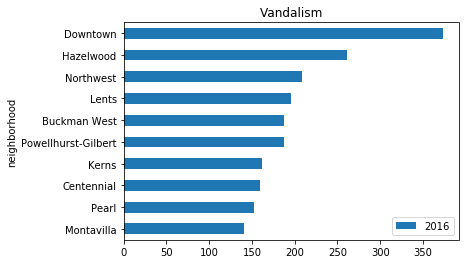

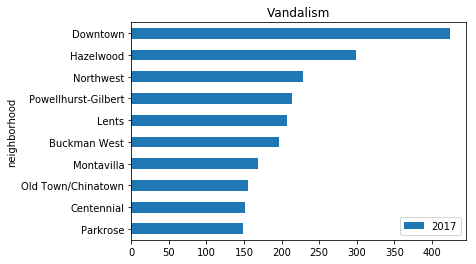

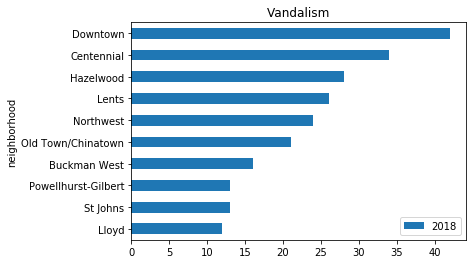

In [143]:
for c in unique_offense_categories:
    print_annual_top10_neighborhoods(c)

In [140]:
# lets get census data and figure out crime/1000 people